In [1]:
import torchaudio
import librosa
import IPython.display as ipd
import numpy as np
import torch
from mne_bids import BIDSPath, read_raw_bids
import pandas as pd
import numpy as np
import torchaudio
from pathlib import Path
from bm.events import *
from scipy.stats import pearsonr
from scipy.signal import coherence,correlate
import matplotlib.pyplot as plt

Hostname bagration not defined in /conf/study_paths/study_paths.yaml. Using default paths.


In [2]:
audio_path ='data/gwilliams2022/download/stimuli/audio/lw1_0.wav'

In [3]:
path ='data/gwilliams2022/download/'

In [4]:
speech, sr = torchaudio.load(audio_path)
speech = speech[0].numpy().squeeze()
#speech = librosa.resample(np.asarray(speech), orig_sr=sr, target_sr=16_000)

In [5]:
sr

22050

In [6]:
speech

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [7]:
speech.shape[0]/22050

95.88167800453515

In [8]:
ipd.Audio(data=np.asarray(speech), autoplay=False, rate=22050)

In [9]:
bids_path = BIDSPath(
            subject="05",
            session="0",
            task="0",
            root=path,
            datatype="meg",
        )

In [10]:
bids_path

BIDSPath(
root: data/gwilliams2022/download
datatype: meg
basename: sub-05_ses-0_task-0)

In [11]:
raw = read_raw_bids(bids_path) 

Extracting SQD Parameters from data/gwilliams2022/download/sub-05/ses-0/meg/sub-05_ses-0_task-0_meg.con...
Creating Raw.info structure...
Setting channel info structure...
Creating Info structure...
Ready.
Reading events from data/gwilliams2022/download/sub-05/ses-0/meg/sub-05_ses-0_task-0_events.tsv.
Reading channel info from data/gwilliams2022/download/sub-05/ses-0/meg/sub-05_ses-0_task-0_channels.tsv.
The stimulus channel "STI 014" is present in the raw data, but not included in channels.tsv. Removing the channel.


/tmp/ipykernel_1723985/3824812548.py:1: RuntimeWarning: The unit for channel(s) MISC 001, MISC 002, MISC 003, MISC 004, MISC 005, MISC 006, MISC 007, MISC 008, MISC 009, MISC 010, MISC 011, MISC 012, MISC 013, MISC 014, MISC 015, MISC 016, MISC 017, MISC 018, MISC 019, MISC 020, MISC 021, MISC 022, MISC 023, MISC 024, MISC 025, MISC 026, MISC 027, MISC 028, MISC 029, MISC 030, MISC 031, MISC 032 has changed from V to NA.
  raw = read_raw_bids(bids_path)


In [12]:
picks = dict(meg=True, eeg=False, stim=False, eog=False, ecg=False, misc=False)
raw = raw.pick_types(**picks)

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [13]:
raw.info["sfreq"]

1000.0

In [14]:
raw.annotations

<Annotations | 3134 segments: {'story': 'lw1', 'story_uid': 0.0, ...>

In [15]:
events = list()
for annot in raw.annotations:
        event = eval(annot.pop("description"))
        event['start'] = annot['onset']
        event['duration'] = annot['duration']
        if event["kind"] == "sound":
            stem, _, ext = event["sound"].lower().rsplit(".", 2)
            event["filepath"] = Path(path) / (stem + "." + ext)
        events.append(event)

events_df = pd.DataFrame(events)
events_df[['language', 'modality']] = 'english', 'audio'
events_df = extract_sequence_info(events_df)
events_df = events_df.event.create_blocks(groupby='sentence')

In [16]:
events_df

,story,story_uid,sound_id,kind,start,sound,duration,filepath,phoneme,sequence_id,...,speech_rate,voice,pronounced,word,language,modality,word_sequence,phoneme_id,offset,uid
0,NaN,NaN,NaN,block,17.026,NaN,6.250000,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,english,audio,NaN,NaN,NaN,Tara stood stock still waiting for the first t...
1,lw1,0.0,0.0,word,17.026,stimuli/audio/lw1_0.wav,0.300000,NaN,NaN,0.0,...,205.0,Allison,1.0,Tara,english,audio,Tara stood stock still waiting for the first t...,NaN,NaN,NaN
2,lw1,0.0,0.0,sound,17.026,stimuli/audio/lw1_0.0.wav,95.881678,/home/zubrikhina/brainmagick_MICCAI/data/gwill...,NaN,NaN,...,NaN,NaN,NaN,NaN,english,audio,NaN,NaN,0.0,NaN
3,lw1,0.0,0.0,phoneme,17.026,stimuli/audio/lw1_0.wav,0.080000,NaN,t_B,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,0.0,NaN,NaN
4,lw1,0.0,0.0,phoneme,17.106,stimuli/audio/lw1_0.wav,0.090000,NaN,eh_I,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3167,lw1,0.0,3.0,phoneme,364.345,stimuli/audio/lw1_3.wav,0.090000,NaN,p_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,1.0,NaN,NaN
3168,lw1,0.0,3.0,phoneme,364.435,stimuli/audio/lw1_3.wav,0.090000,NaN,iy_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,2.0,NaN,NaN
3169,lw1,0.0,3.0,phoneme,364.525,stimuli/audio/lw1_3.wav,0.080000,NaN,sh_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,3.0,NaN,NaN
3170,lw1,0.0,3.0,phoneme,364.605,stimuli/audio/lw1_3.wav,0.010000,NaN,iy_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,4.0,NaN,NaN


In [17]:
events_df.loc[events_df.sound == 'stimuli/audio/lw1_0.wav']

,story,story_uid,sound_id,kind,start,sound,duration,filepath,phoneme,sequence_id,...,speech_rate,voice,pronounced,word,language,modality,word_sequence,phoneme_id,offset,uid
1,lw1,0.0,0.0,word,17.026,stimuli/audio/lw1_0.wav,0.30,NaN,NaN,0.0,...,205.0,Allison,1.0,Tara,english,audio,Tara stood stock still waiting for the first t...,NaN,NaN,NaN
3,lw1,0.0,0.0,phoneme,17.026,stimuli/audio/lw1_0.wav,0.08,NaN,t_B,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,0.0,NaN,NaN
4,lw1,0.0,0.0,phoneme,17.106,stimuli/audio/lw1_0.wav,0.09,NaN,eh_I,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,1.0,NaN,NaN
5,lw1,0.0,0.0,phoneme,17.196,stimuli/audio/lw1_0.wav,0.07,NaN,r_I,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,2.0,NaN,NaN
6,lw1,0.0,0.0,phoneme,17.266,stimuli/audio/lw1_0.wav,0.06,NaN,ah_E,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,3.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
877,lw1,0.0,0.0,phoneme,111.556,stimuli/audio/lw1_0.wav,0.10,NaN,ih_I,13.0,...,145.0,Allison,1.0,NaN,english,audio,NaN,3.0,NaN,NaN
878,lw1,0.0,0.0,phoneme,111.656,stimuli/audio/lw1_0.wav,0.08,NaN,zh_I,13.0,...,145.0,Allison,1.0,NaN,english,audio,NaN,4.0,NaN,NaN
879,lw1,0.0,0.0,phoneme,111.736,stimuli/audio/lw1_0.wav,0.10,NaN,ah_I,13.0,...,145.0,Allison,1.0,NaN,english,audio,NaN,5.0,NaN,NaN
880,lw1,0.0,0.0,phoneme,111.836,stimuli/audio/lw1_0.wav,0.19,NaN,n_I,13.0,...,145.0,Allison,1.0,NaN,english,audio,NaN,6.0,NaN,NaN


In [18]:
events_df

,story,story_uid,sound_id,kind,start,sound,duration,filepath,phoneme,sequence_id,...,speech_rate,voice,pronounced,word,language,modality,word_sequence,phoneme_id,offset,uid
0,NaN,NaN,NaN,block,17.026,NaN,6.250000,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,english,audio,NaN,NaN,NaN,Tara stood stock still waiting for the first t...
1,lw1,0.0,0.0,word,17.026,stimuli/audio/lw1_0.wav,0.300000,NaN,NaN,0.0,...,205.0,Allison,1.0,Tara,english,audio,Tara stood stock still waiting for the first t...,NaN,NaN,NaN
2,lw1,0.0,0.0,sound,17.026,stimuli/audio/lw1_0.0.wav,95.881678,/home/zubrikhina/brainmagick_MICCAI/data/gwill...,NaN,NaN,...,NaN,NaN,NaN,NaN,english,audio,NaN,NaN,0.0,NaN
3,lw1,0.0,0.0,phoneme,17.026,stimuli/audio/lw1_0.wav,0.080000,NaN,t_B,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,0.0,NaN,NaN
4,lw1,0.0,0.0,phoneme,17.106,stimuli/audio/lw1_0.wav,0.090000,NaN,eh_I,0.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3167,lw1,0.0,3.0,phoneme,364.345,stimuli/audio/lw1_3.wav,0.090000,NaN,p_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,1.0,NaN,NaN
3168,lw1,0.0,3.0,phoneme,364.435,stimuli/audio/lw1_3.wav,0.090000,NaN,iy_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,2.0,NaN,NaN
3169,lw1,0.0,3.0,phoneme,364.525,stimuli/audio/lw1_3.wav,0.080000,NaN,sh_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,3.0,NaN,NaN
3170,lw1,0.0,3.0,phoneme,364.605,stimuli/audio/lw1_3.wav,0.010000,NaN,iy_I,52.0,...,205.0,Allison,1.0,NaN,english,audio,NaN,4.0,NaN,NaN


Effective window size : 2.048 (s)


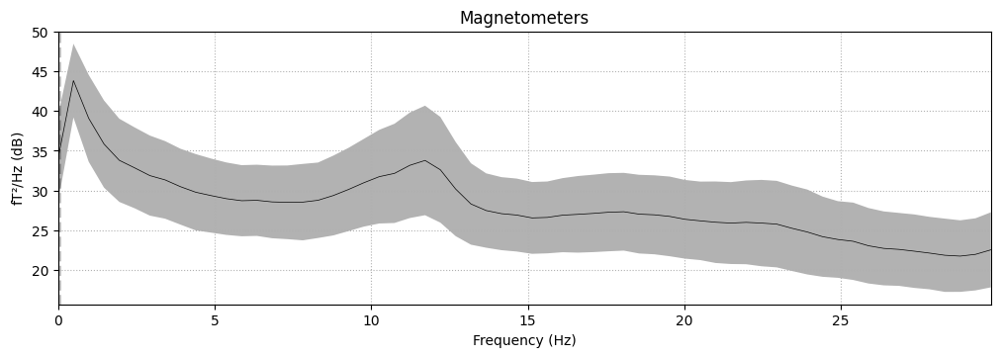

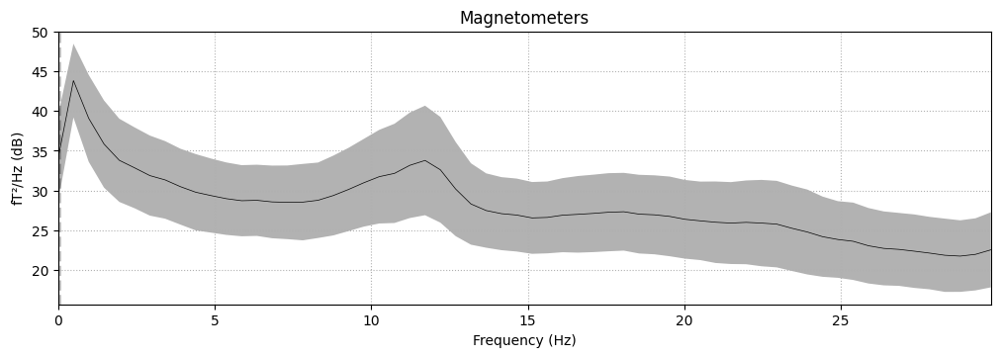

In [19]:
raw.compute_psd(fmax=30).plot(average=True, picks="data", exclude="bads")

In [20]:
raw.resample(sfreq=120)

Measurement date,"January 01, 2000 00:00:00 GMT"
Experimenter,mne_anonymize
Participant,sub-05
Digitized points,Not available
Good channels,208 Magnetometers
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,120.00 Hz
Highpass,0.03 Hz
Lowpass,60.00 Hz


Effective window size : 17.067 (s)


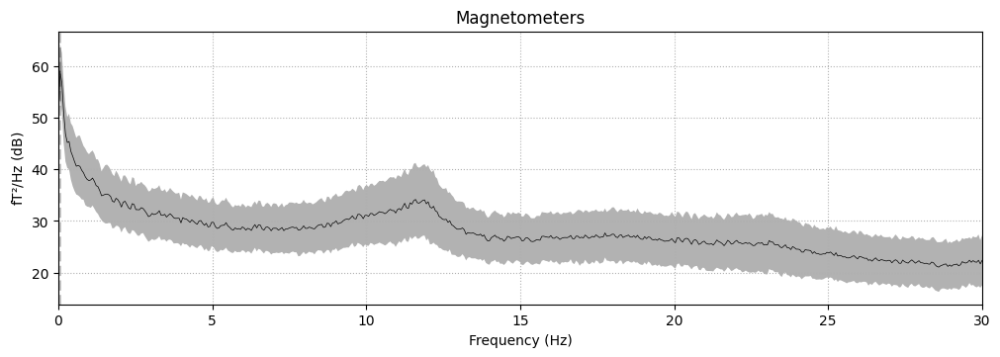

In [21]:
raw.compute_psd(fmax=30).plot(average=True, picks="data", exclude="bads")

In [22]:
brain_activity =raw.get_data()

In [23]:
brain_activity.shape

(208, 46080)

In [24]:
1000/45

22.22222222222222

In [42]:
23506// (1000/45)

1057.0

In [43]:
audio_brain_activity =brain_activity[0, 1057:118506]

In [44]:
audio_brain_activity

array([ 2.47022730e-13, -2.24606154e-13,  4.55494050e-14, ...,
        5.86242010e-15,  4.19039703e-13,  6.35239046e-14])

In [45]:
ipd.Audio(data=np.asarray(speech), autoplay=False, rate=16000)

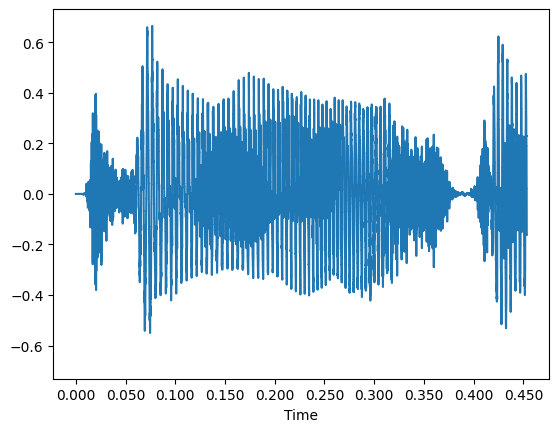

In [46]:
librosa.display.waveshow(speech[: 10000],sr=22050)

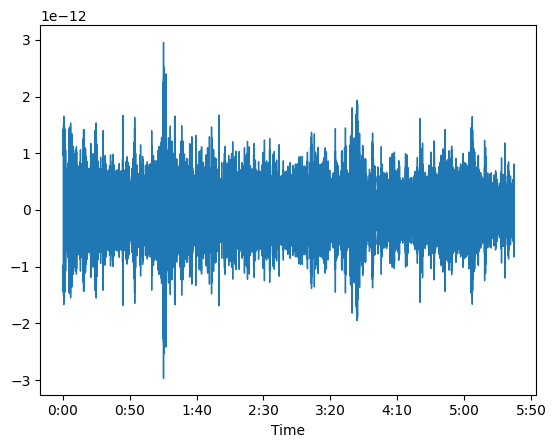

In [48]:
librosa.display.waveshow(audio_brain_activity[1057:],sr=45)

In [ ]:
sr

In [ ]:
speech1000 = librosa.resample(np.asarray(speech), orig_sr=sr, target_sr=45)

In [ ]:
ipd.Audio(data=np.asarray(speech1000), autoplay=True, rate=1000)

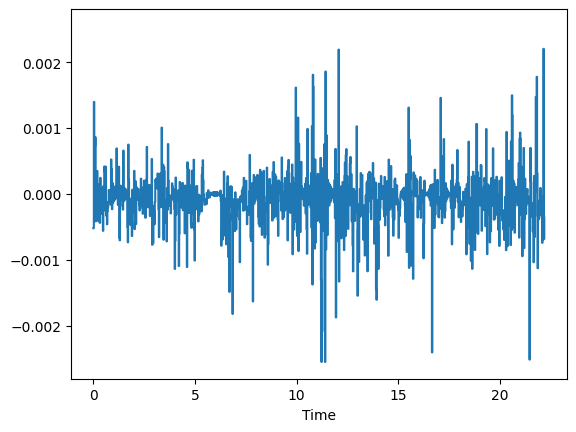

In [29]:
librosa.display.waveshow(speech1000[0: 1000],sr=45)

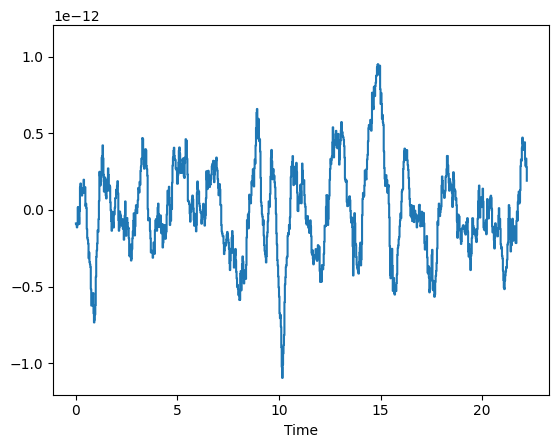

In [30]:
librosa.display.waveshow(brain_activity[12,23506: 23506+1000],sr=45)

In [343]:
speech1000.shape

(95882,)

In [344]:
audio_brain_activity.shape

(95000,)

In [345]:
brain_activity[0, 23506:23506+speech1000.shape[0]]

array([-7.25634061e-14, -8.48143707e-14, -1.70571123e-13, ...,
       -3.86376578e-14, -7.25634061e-14, -1.98842580e-13])

In [38]:
## Посмотрим на сигнал в целом

In [39]:
for i in range(brain_activity.shape[0]):
    corr_pearson =pearsonr(speech1000,brain_activity[i, 23506:23506+speech1000.shape[0]])
    print(corr_pearson)
    if corr_pearson[0]>0.1:
        print(corr_pearson)

PearsonRResult(statistic=-8.651178531136466e-05, pvalue=0.9786289294174446)
PearsonRResult(statistic=0.00010120545991489392, pvalue=0.9750002418553716)
PearsonRResult(statistic=0.0002335728374120705, pvalue=0.9423436963528131)
PearsonRResult(statistic=0.00012138657251724246, pvalue=0.9700172583134061)
PearsonRResult(statistic=5.3493224524490035e-05, pvalue=0.986784552885873)
PearsonRResult(statistic=0.00013120981359242642, pvalue=0.9675921816190227)
PearsonRResult(statistic=0.0003682520479190662, pvalue=0.9092163136683203)
PearsonRResult(statistic=0.00038745781720958387, pvalue=0.9045037035982912)
PearsonRResult(statistic=0.0003035525462909793, pvalue=0.9251145008257531)
PearsonRResult(statistic=-0.0002790310008646294, pvalue=0.9311481934059608)
PearsonRResult(statistic=0.0004138529957541919, pvalue=0.8980325115720041)
PearsonRResult(statistic=-0.00019196820069075177, pvalue=0.9526001956290251)
PearsonRResult(statistic=-4.043031051786892e-05, pvalue=0.9900115367801823)
PearsonRResult(s

In [390]:
for i in range(brain_activity.shape[0]):
    corr =correlate(brain_activity[i, 23506:23506+speech1000.shape[0]], speech1000)
    print(corr.max())
    print(corr.argmax())
    print("_________")
    

1.3455702044089682e-11
94905
_________
1.2887136264977013e-11
98165
_________
1.9533137495216613e-11
87417
_________
1.5926390059395074e-11
104594
_________
1.382449007184401e-11
98545
_________
1.2619882763309982e-11
109013
_________
1.2284096320126451e-11
83897
_________
1.3260647386356218e-11
96351
_________
1.528179371672322e-11
96624
_________
1.3696195551299222e-11
101557
_________
1.5240010877131048e-11
107774
_________
1.292200379658195e-11
87434
_________
1.4129353928078078e-11
85467
_________
1.5598915499146344e-11
95898
_________
1.4402345575912675e-11
90647
_________
1.3018208793511701e-11
83109
_________
1.1531316961434044e-11
76396
_________
1.4550375256332437e-11
102132
_________
1.606762786752664e-11
84129
_________
1.520671318234006e-11
71868
_________
1.4844946123332525e-11
84129
_________
1.7429059441222754e-11
79880
_________
1.6793882716094175e-11
75797
_________
1.6525501734631362e-11
99149
_________
1.4904773815243408e-11
99036
_________
2.1438199498455993e-11
95

In [40]:
brain_activity[i, 23506:23506+speech1000.shape[0]].shape

(95882,)

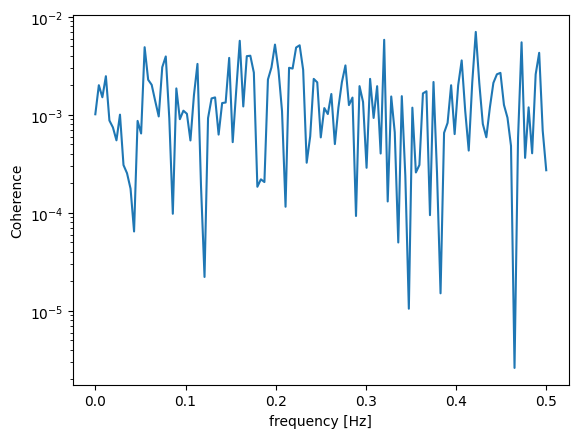

______________________


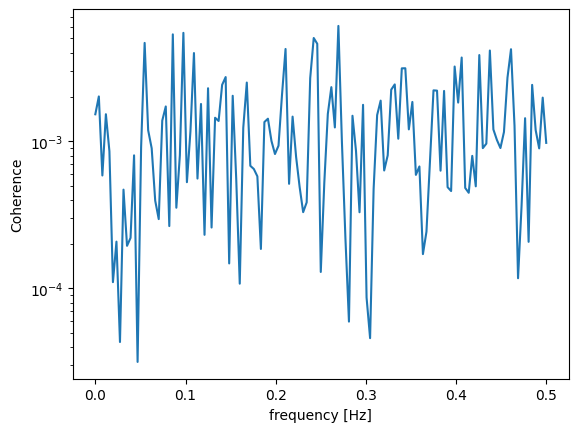

______________________


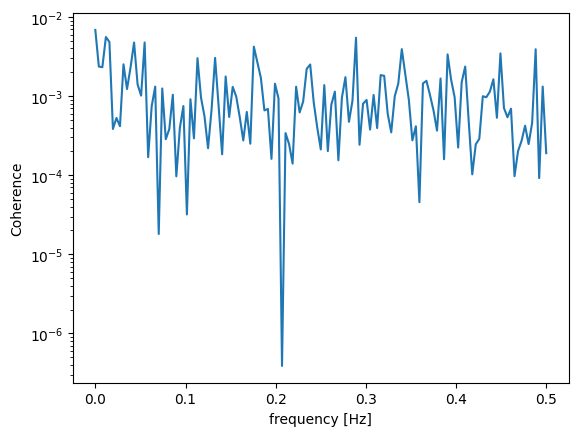

______________________


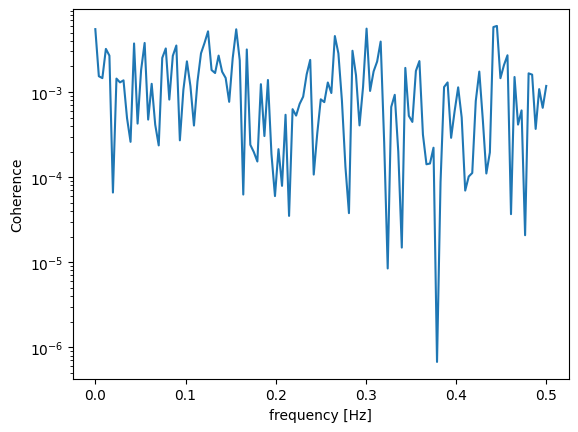

______________________


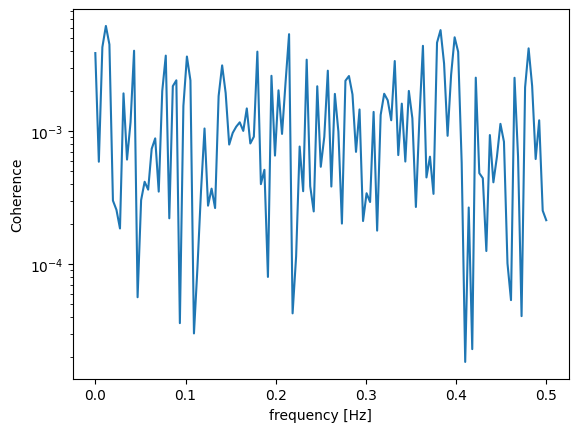

______________________


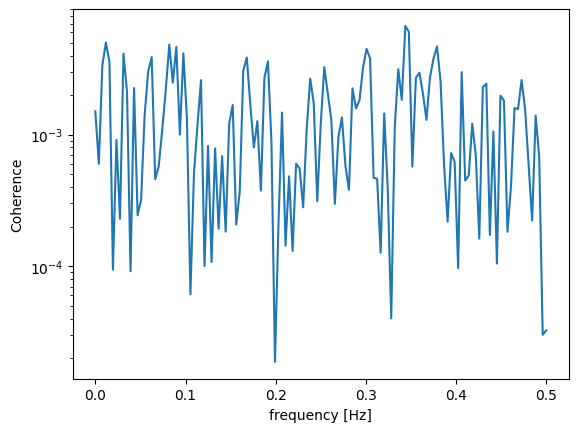

______________________


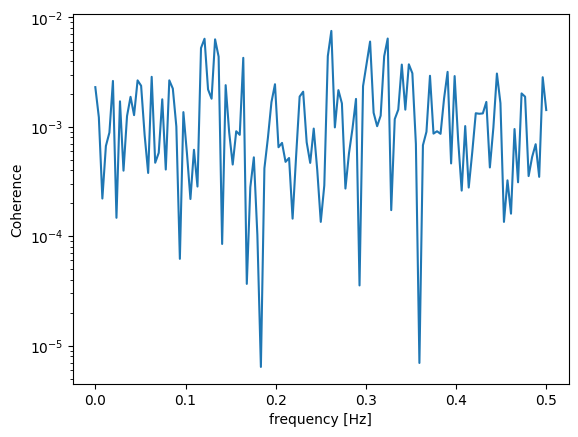

______________________


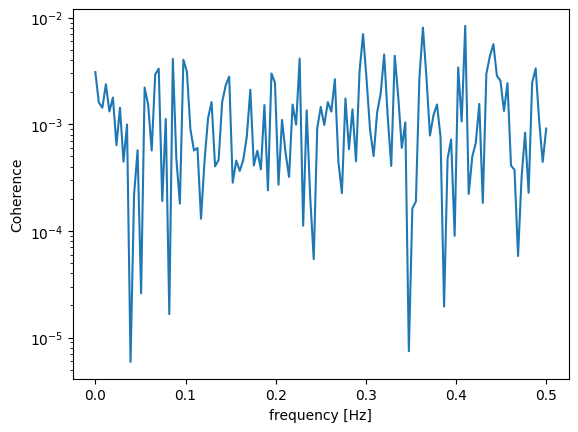

______________________


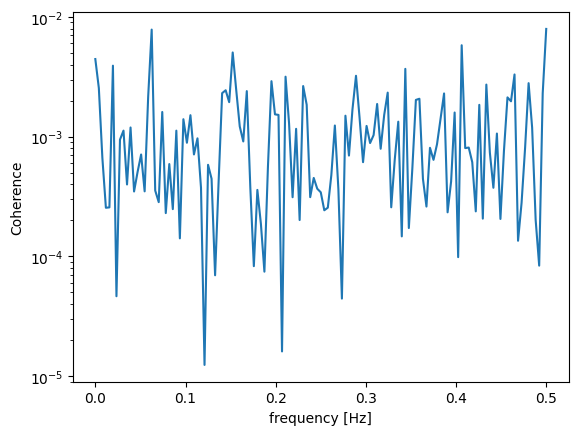

______________________


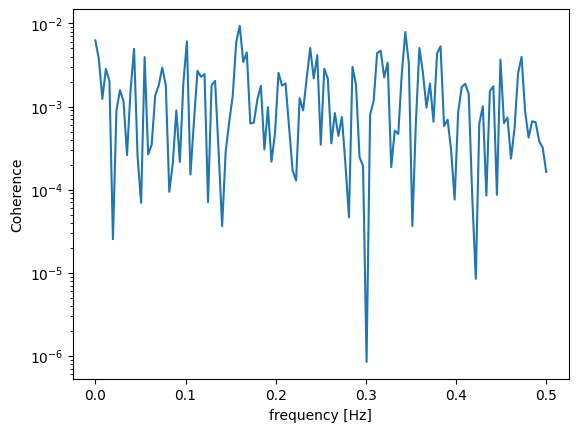

______________________


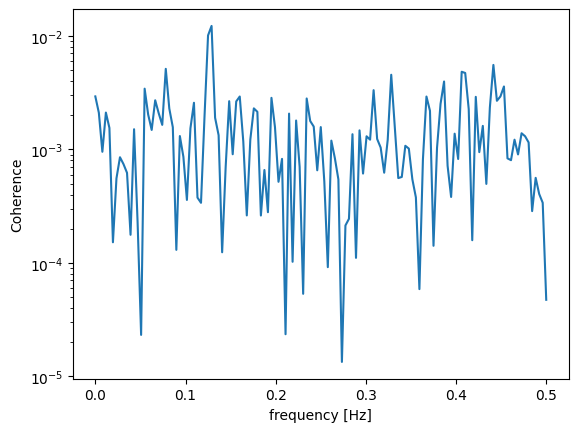

______________________


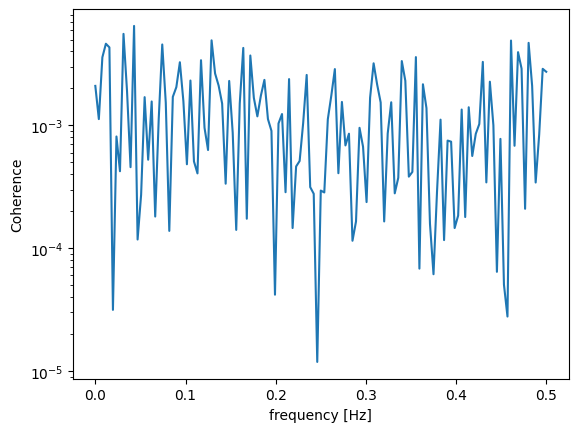

______________________


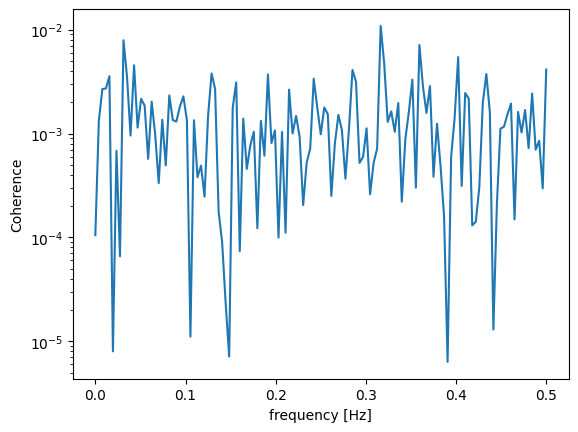

______________________


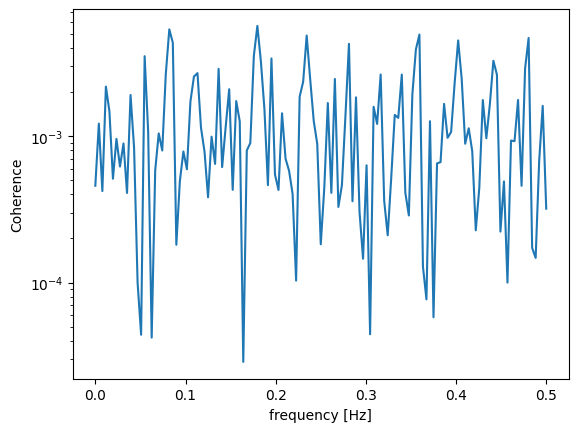

______________________


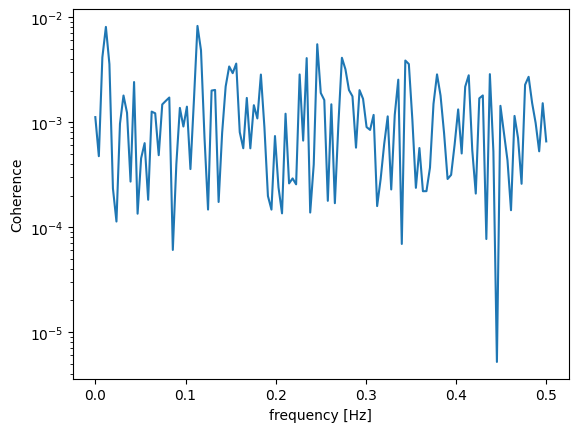

______________________


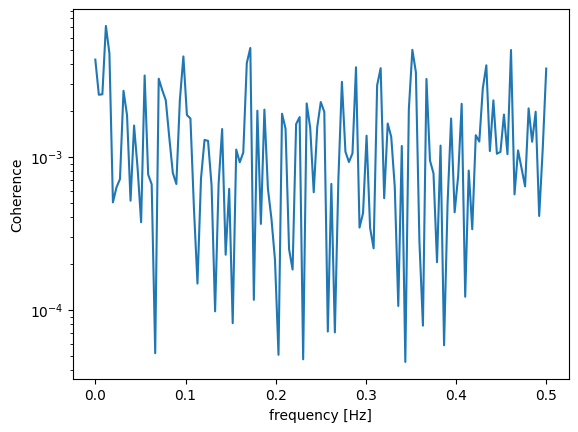

______________________


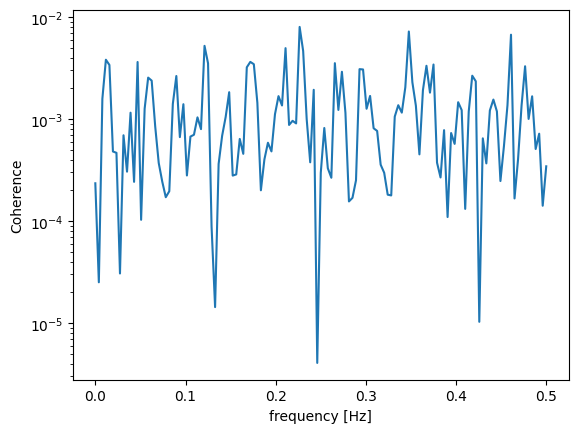

______________________


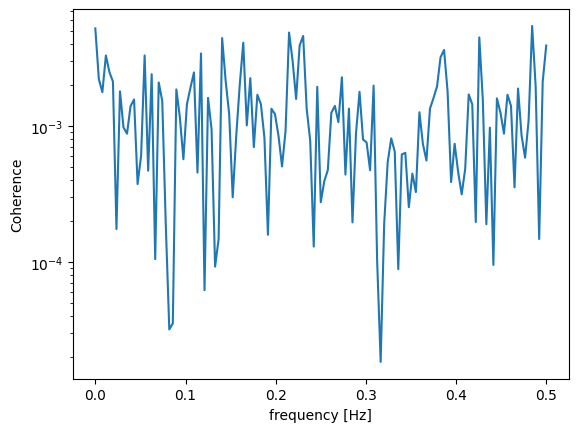

______________________


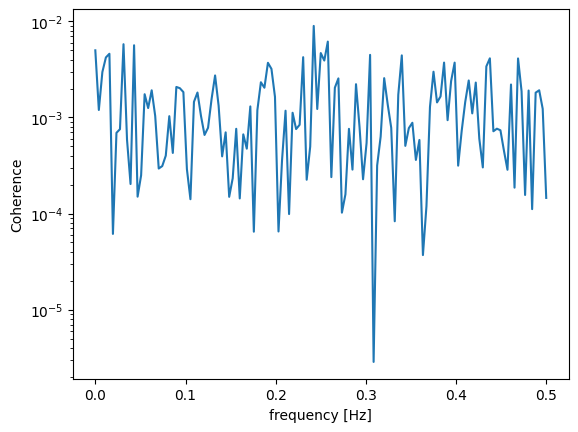

______________________


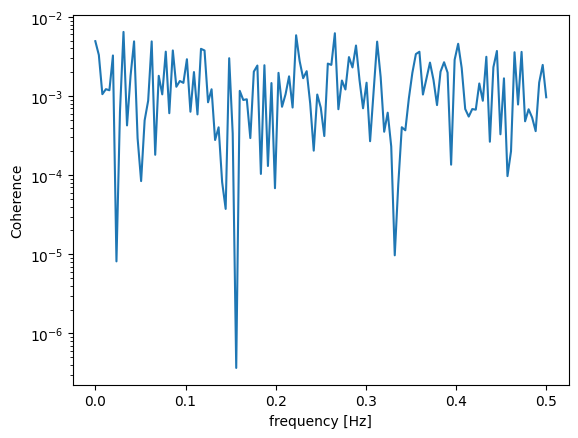

______________________


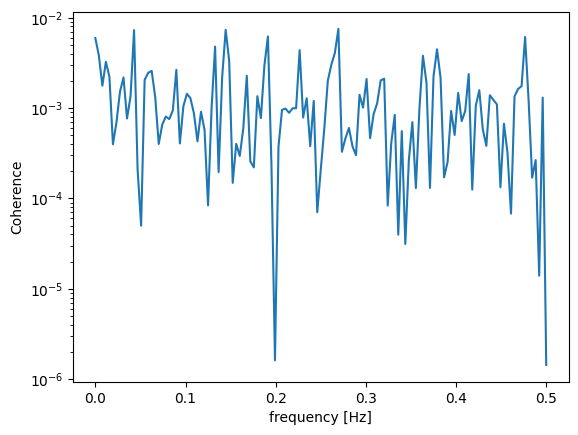

______________________


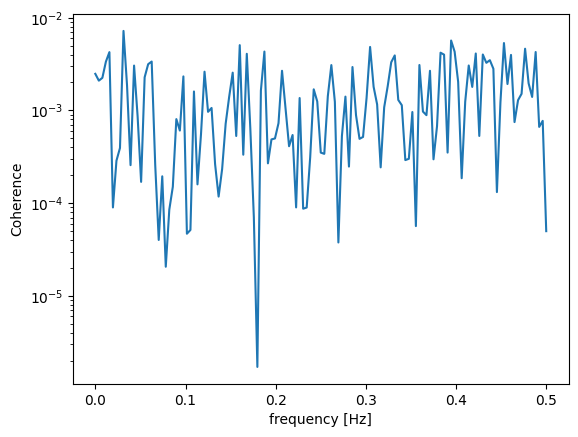

______________________


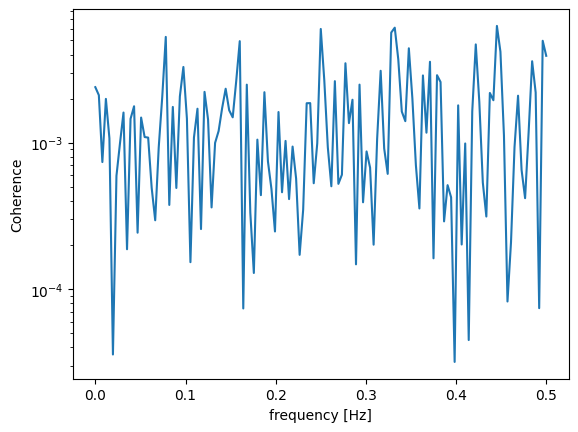

______________________


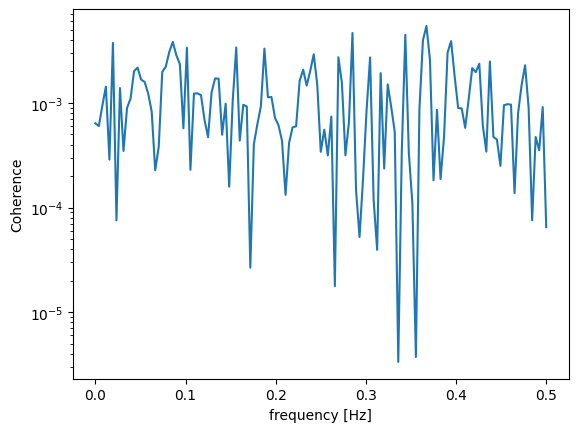

______________________


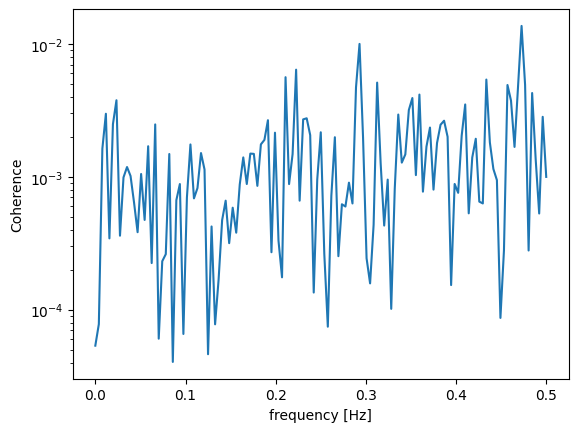

______________________


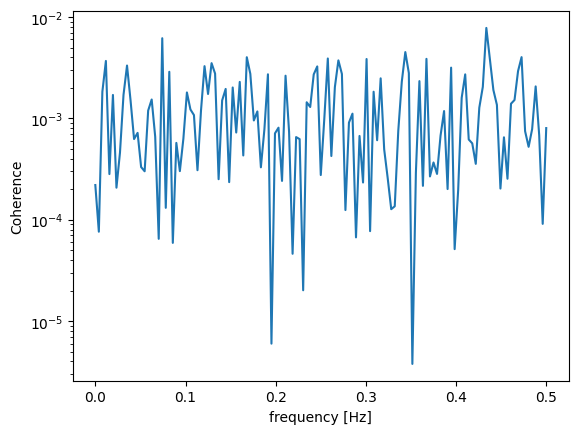

______________________


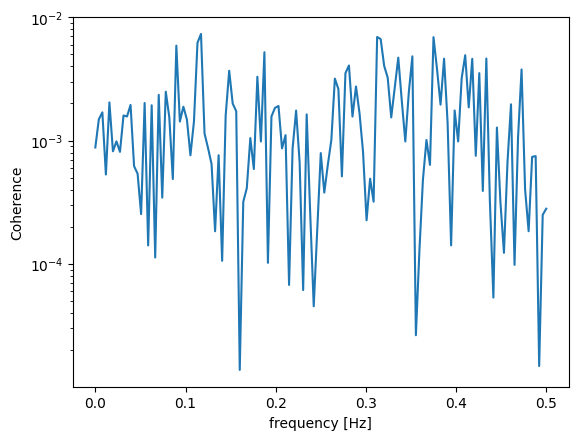

______________________


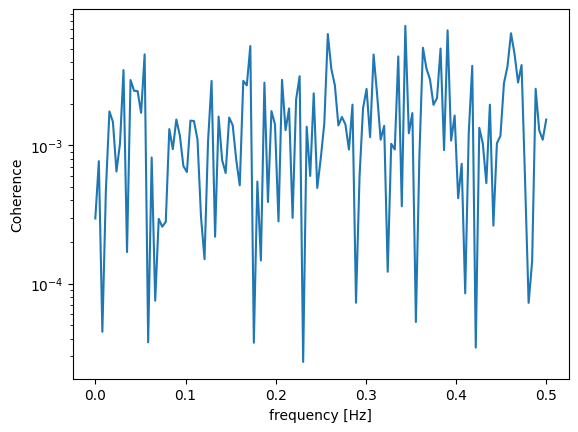

______________________


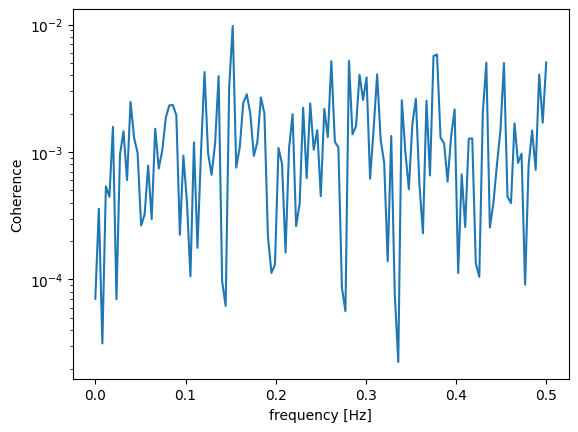

______________________


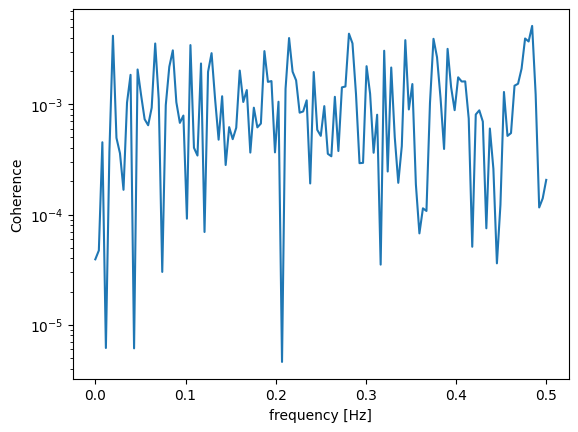

______________________


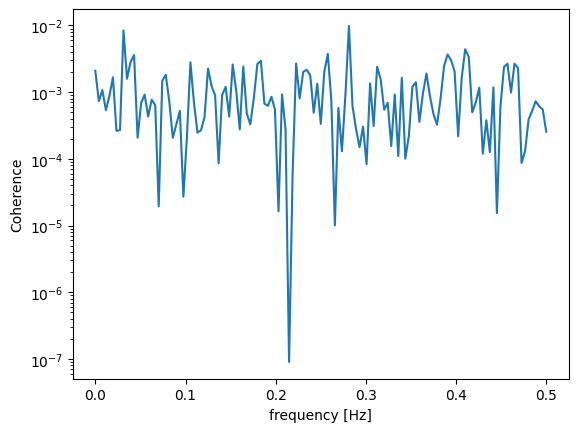

______________________


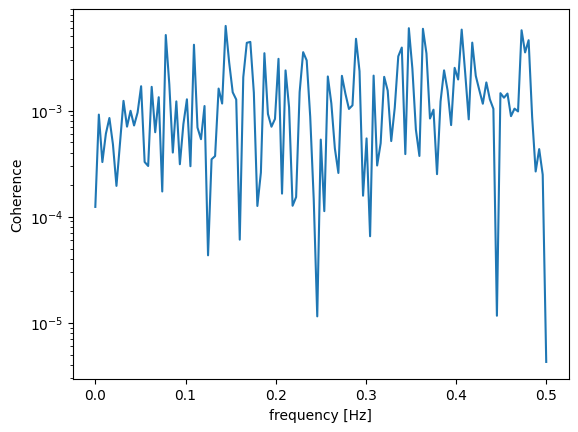

______________________


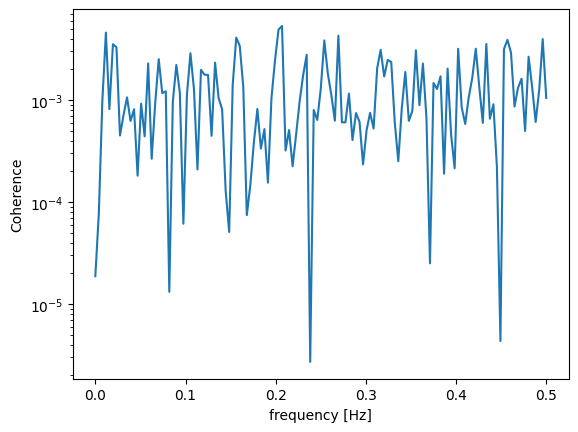

______________________


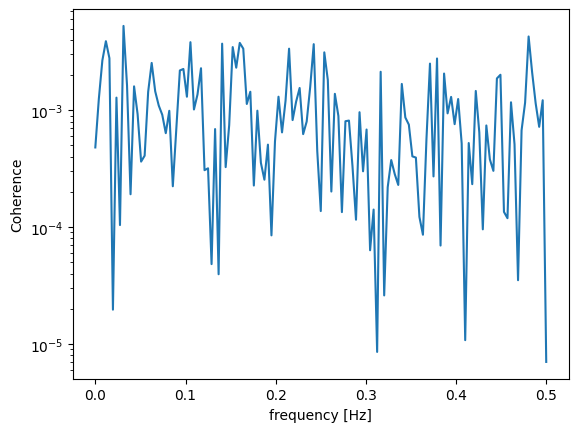

______________________


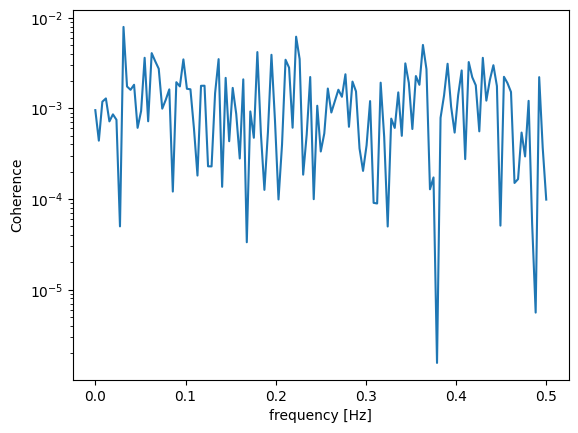

______________________


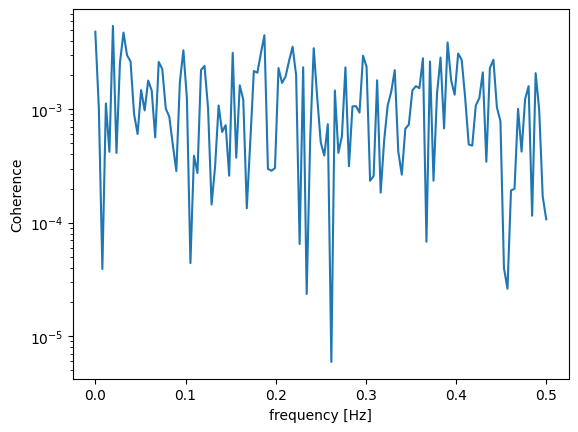

______________________


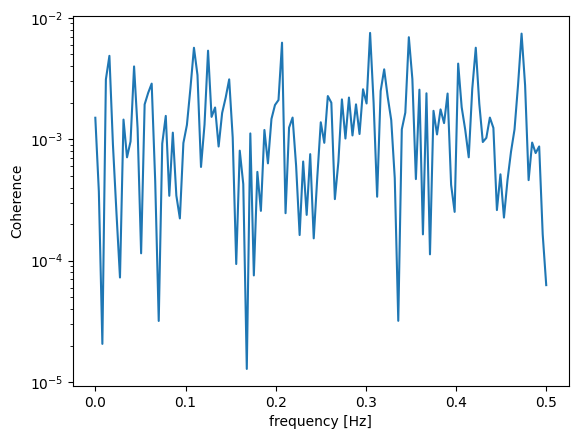

______________________


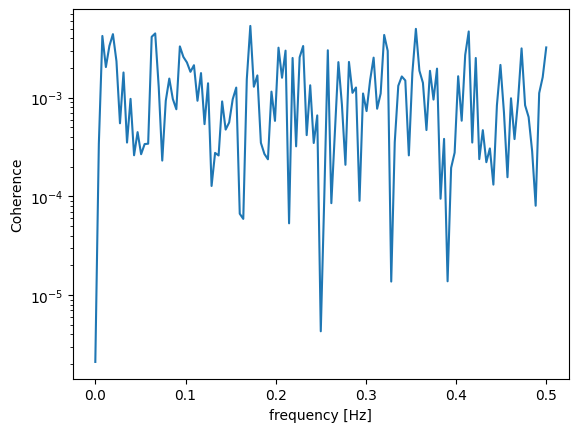

______________________


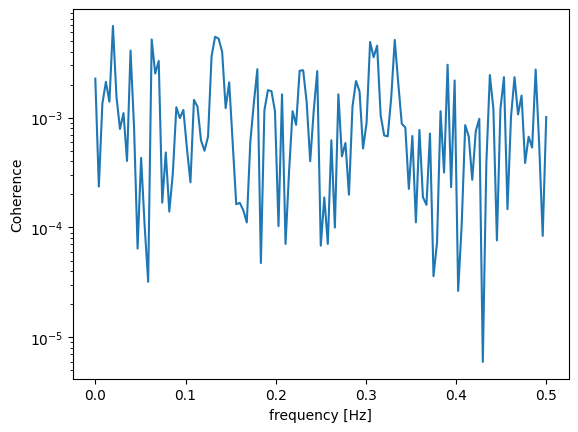

______________________


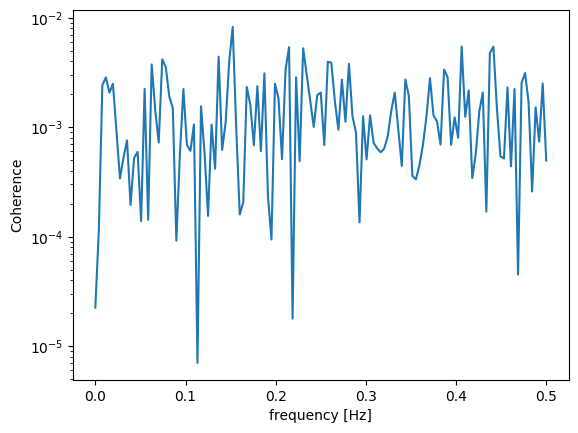

______________________


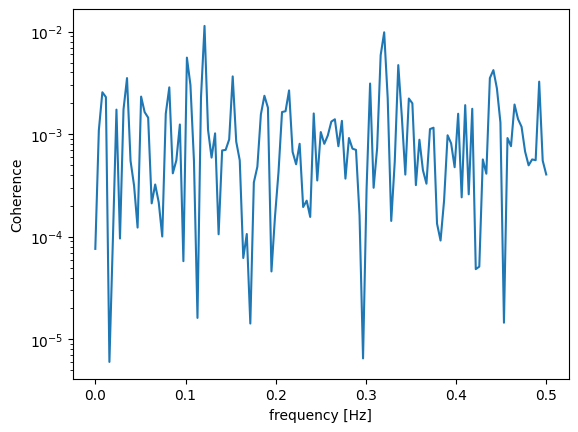

______________________


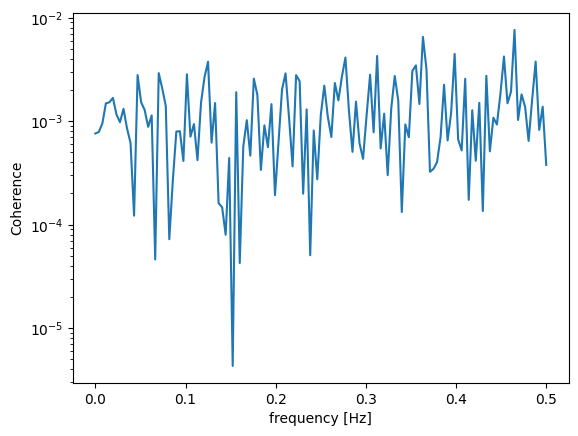

______________________


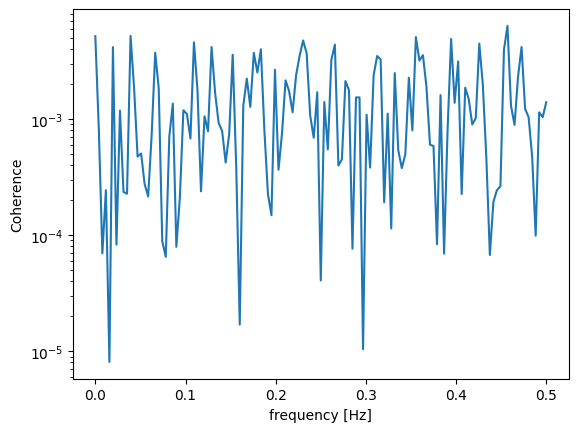

______________________


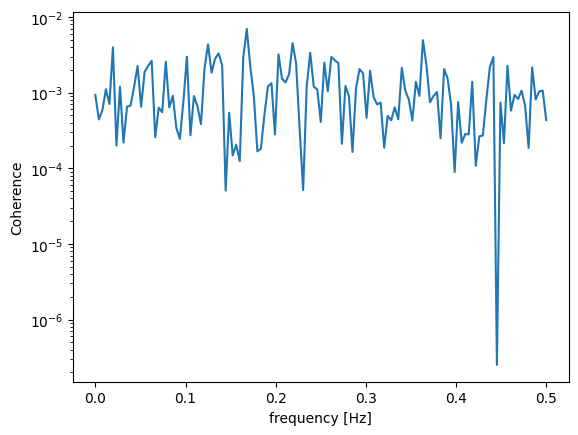

______________________


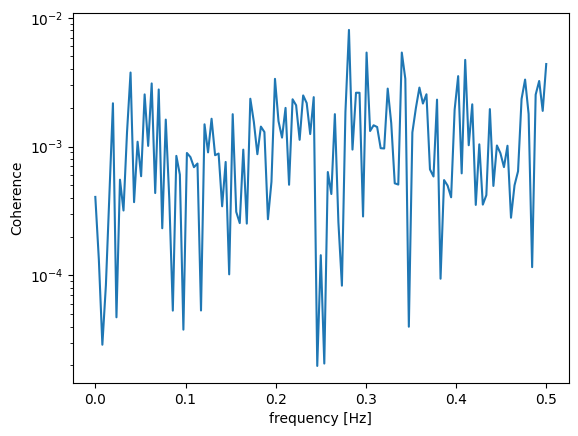

______________________


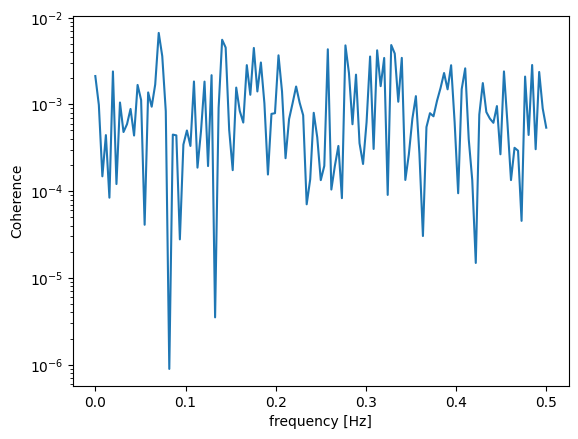

______________________


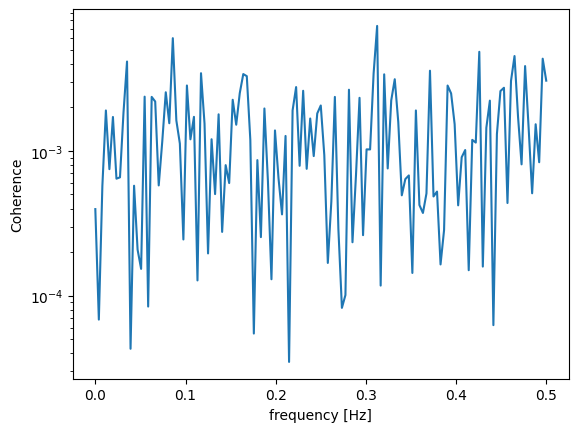

______________________


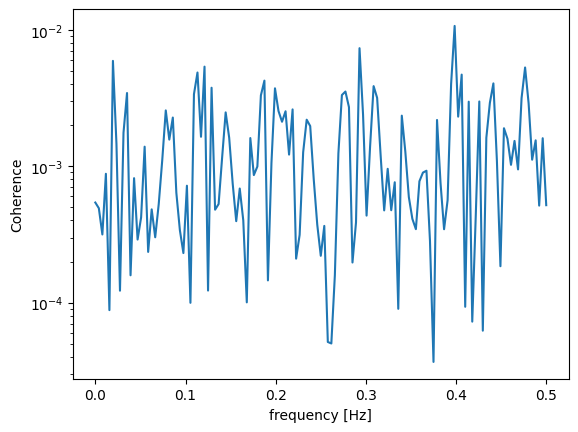

______________________


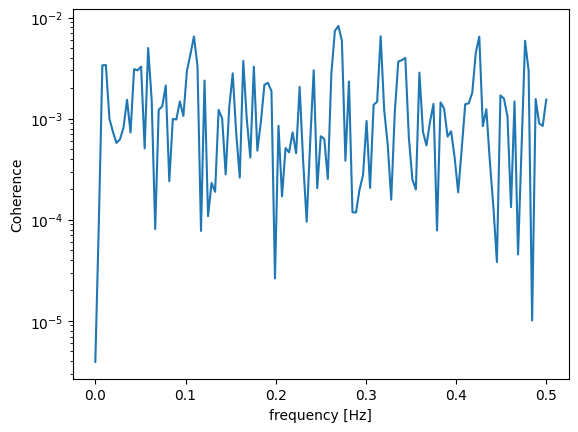

______________________


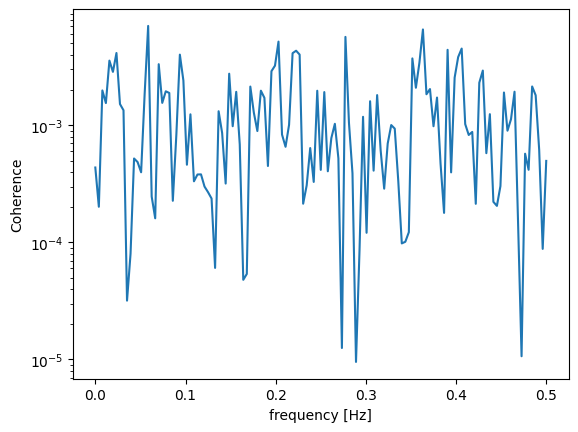

______________________


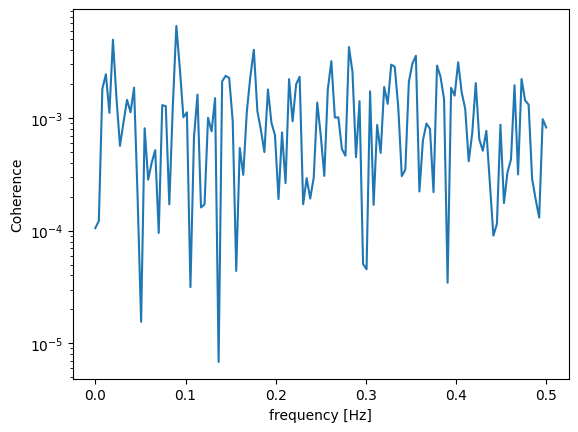

______________________


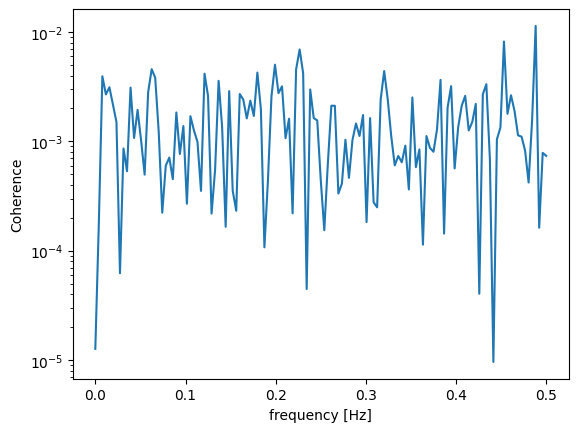

______________________


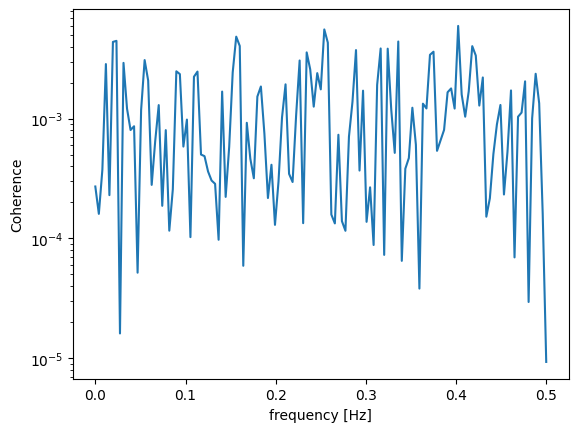

______________________


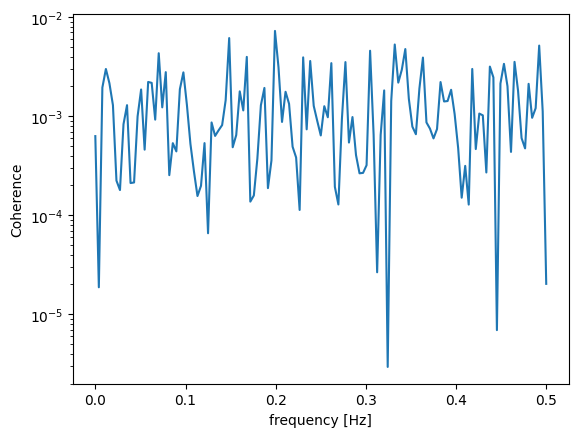

______________________


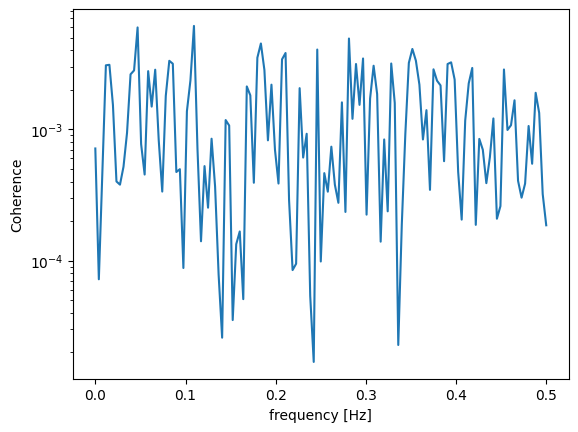

______________________


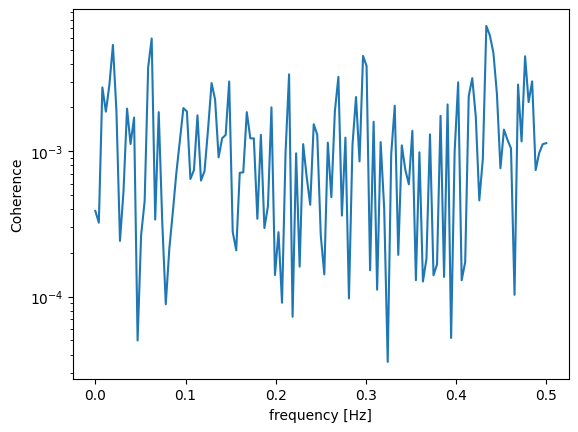

______________________


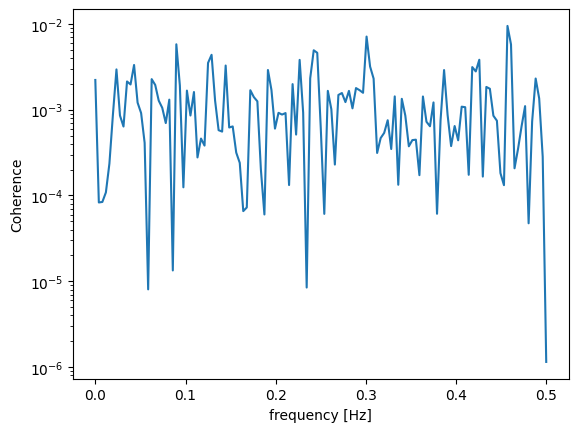

______________________


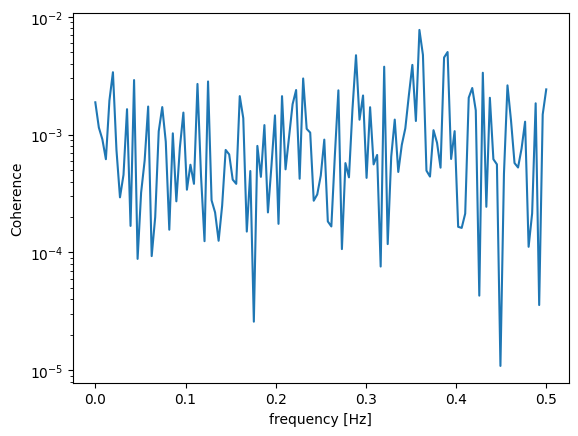

______________________


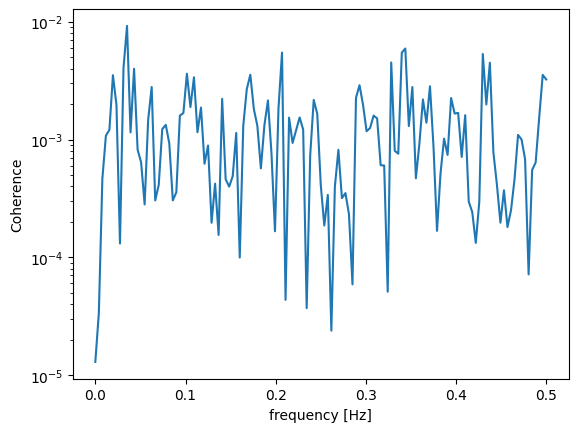

______________________


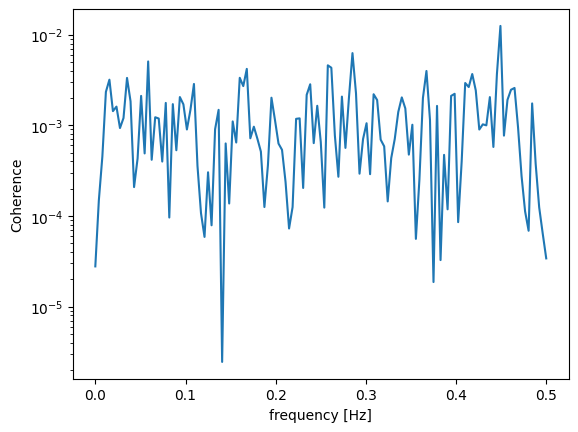

______________________


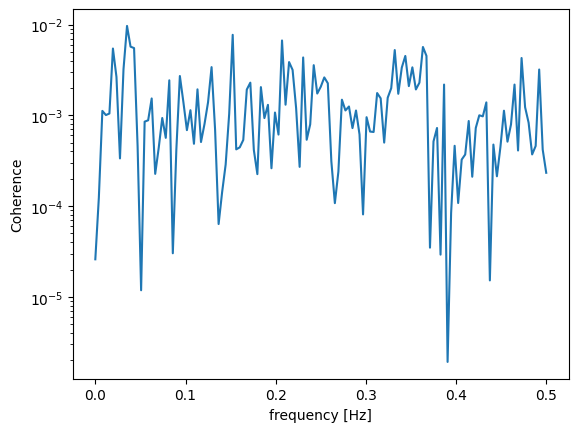

______________________


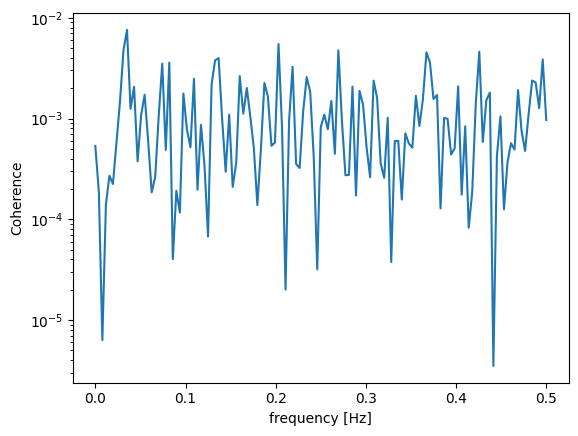

______________________


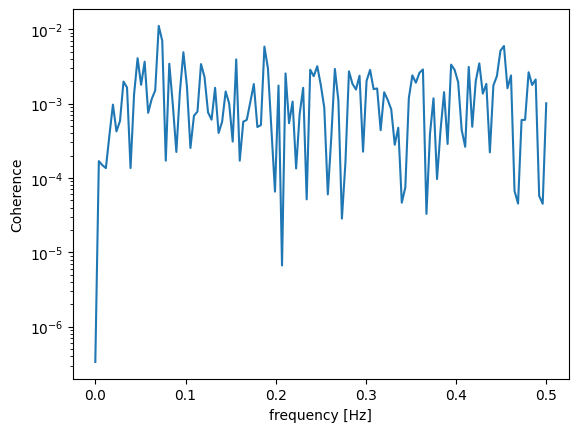

______________________


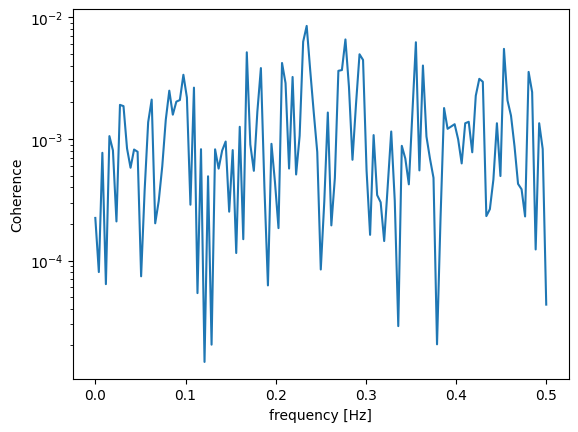

______________________


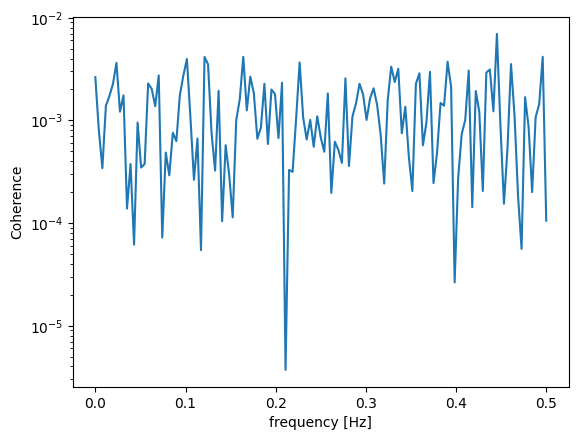

______________________


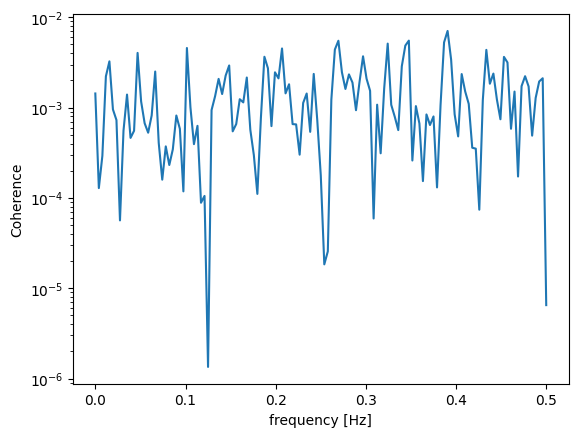

______________________


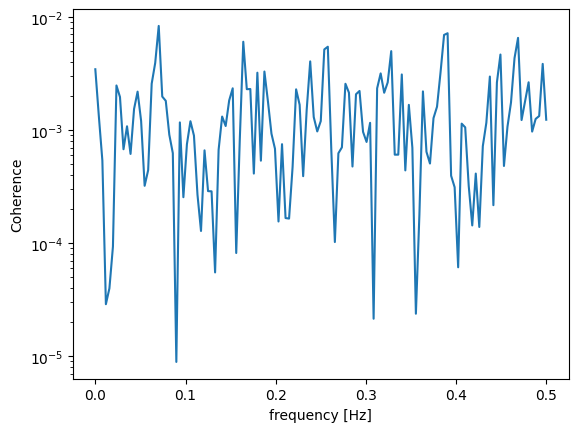

______________________


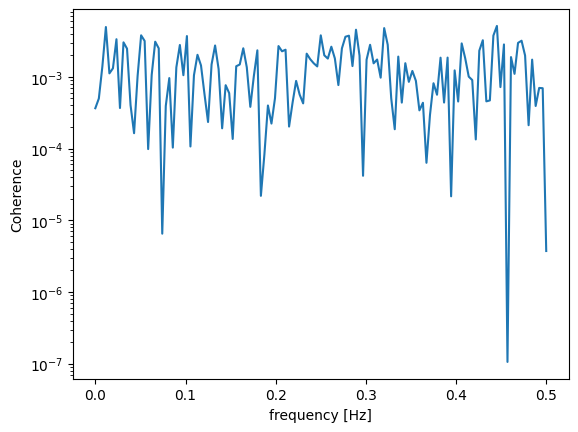

______________________


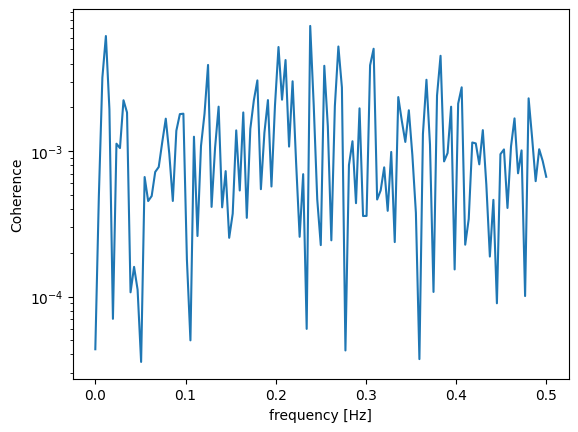

______________________


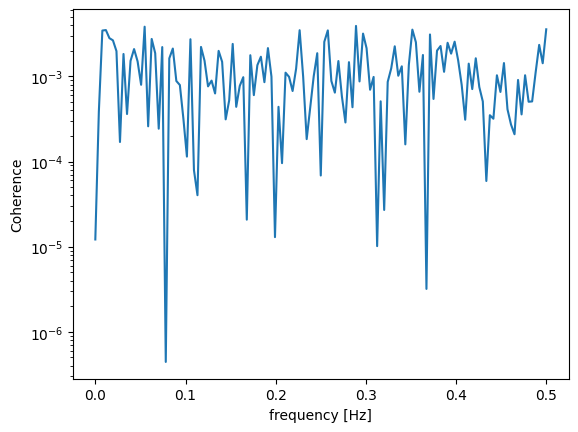

______________________


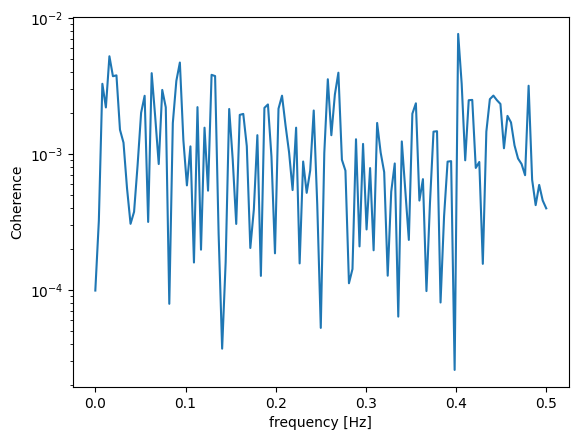

______________________


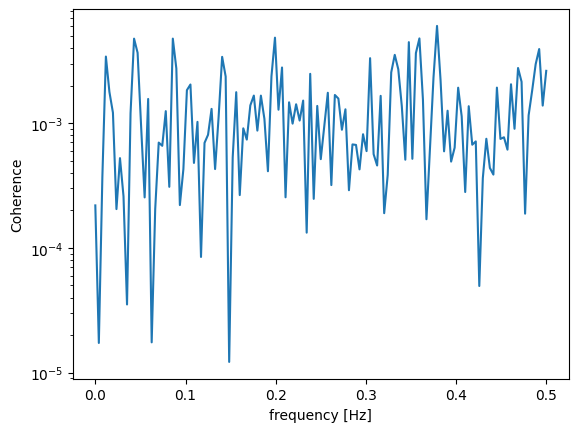

______________________


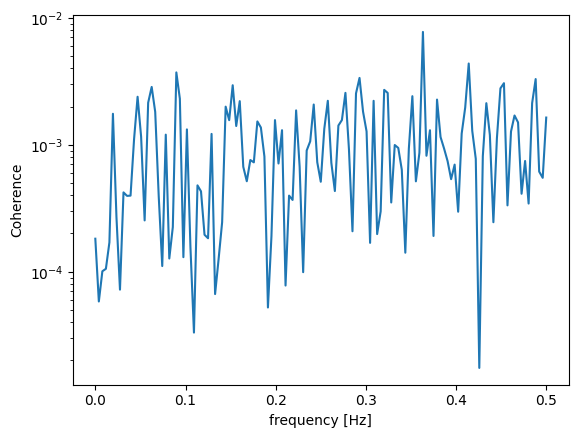

______________________


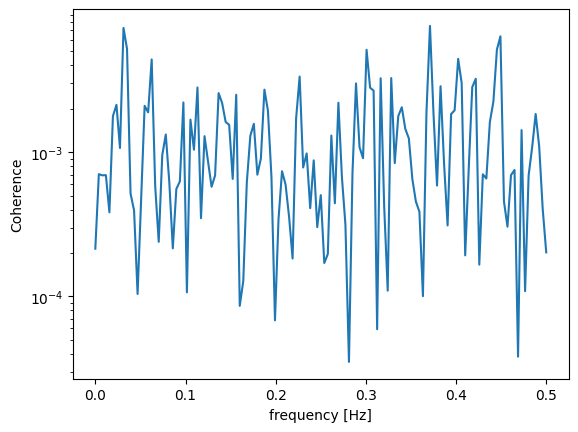

______________________


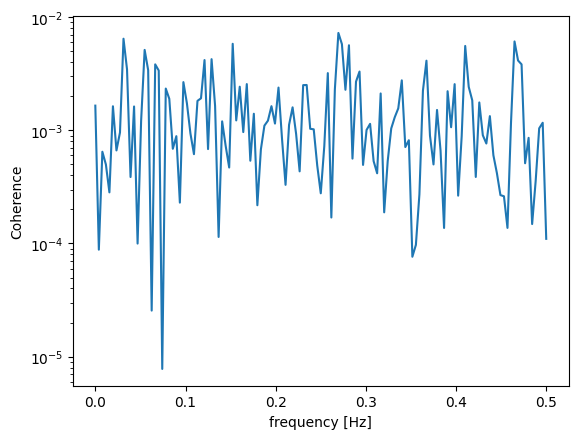

______________________


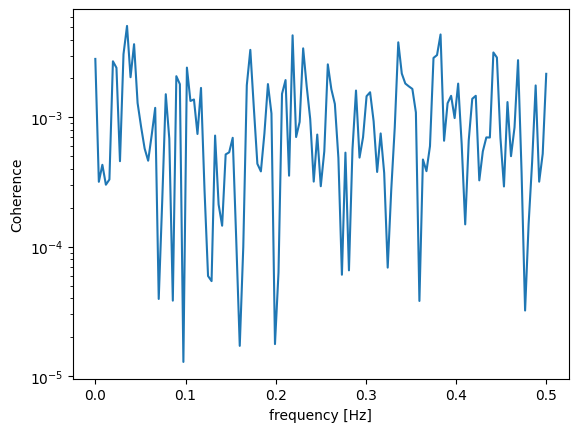

______________________


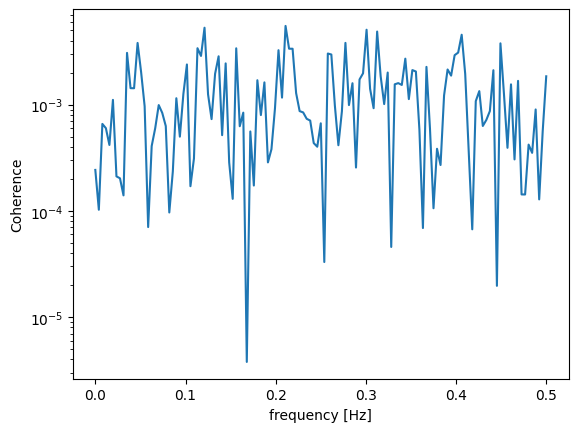

______________________


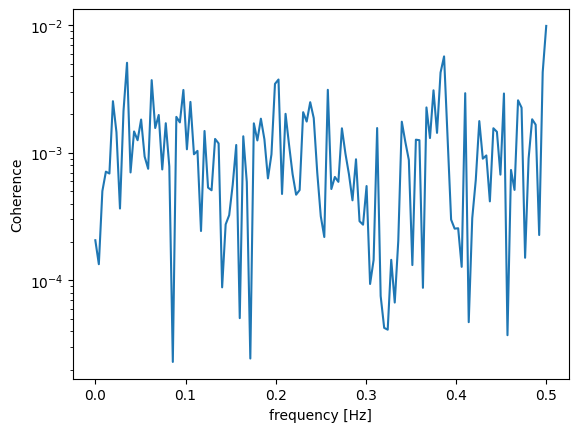

______________________


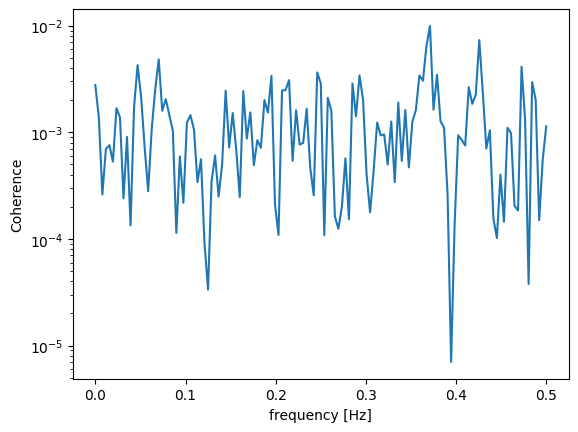

______________________


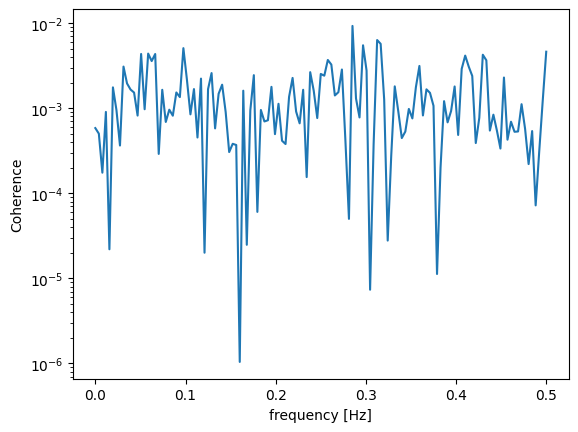

______________________


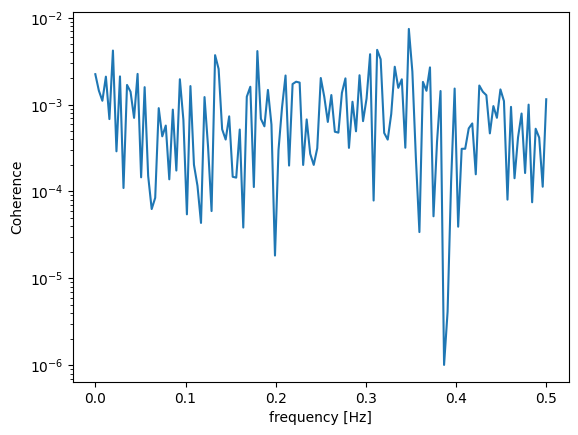

______________________


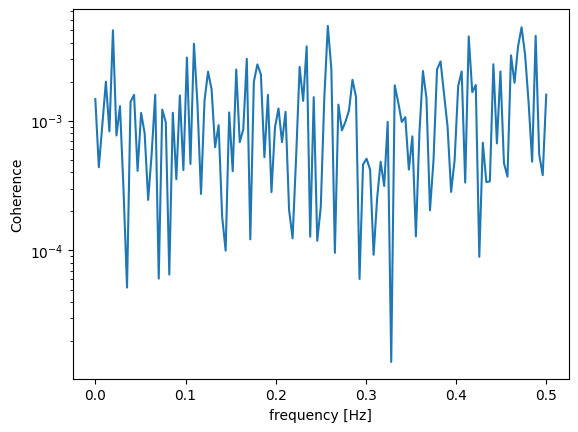

______________________


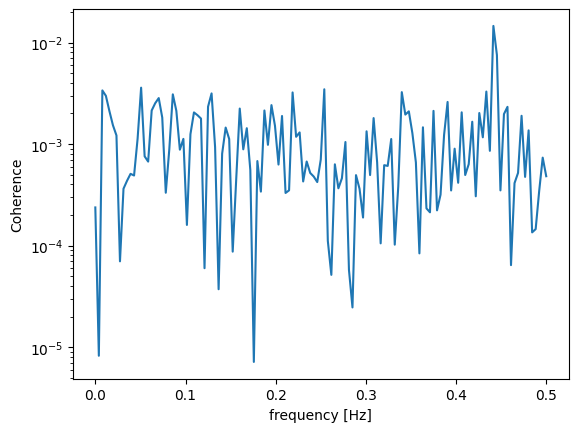

______________________


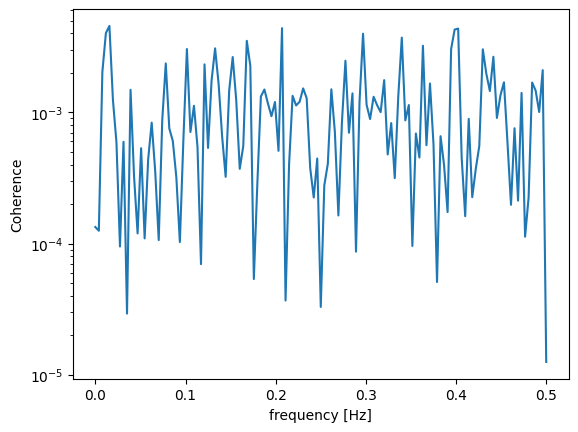

______________________


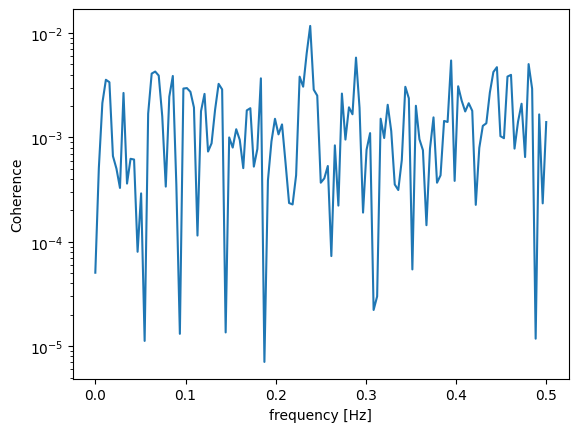

______________________


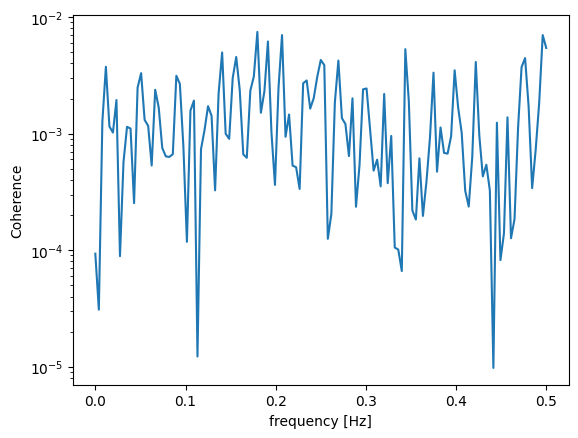

______________________


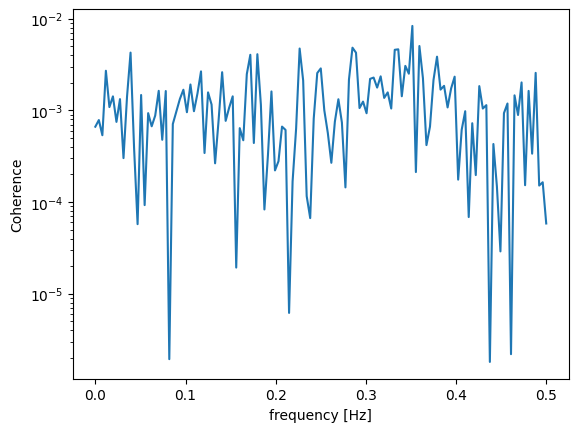

______________________


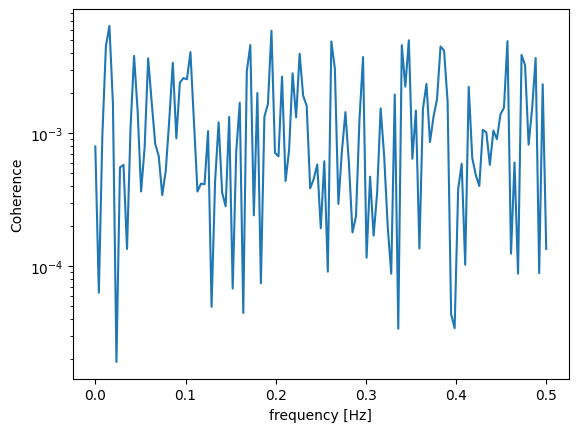

______________________


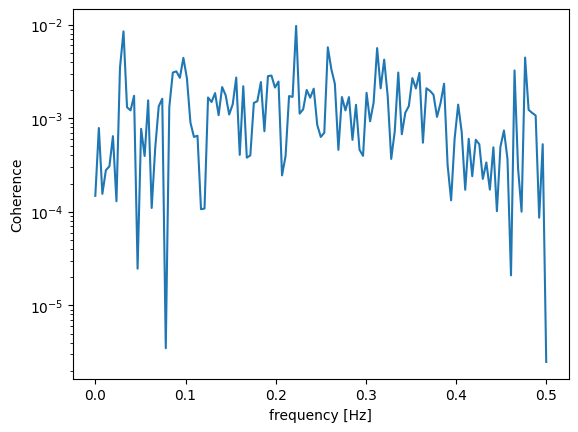

______________________


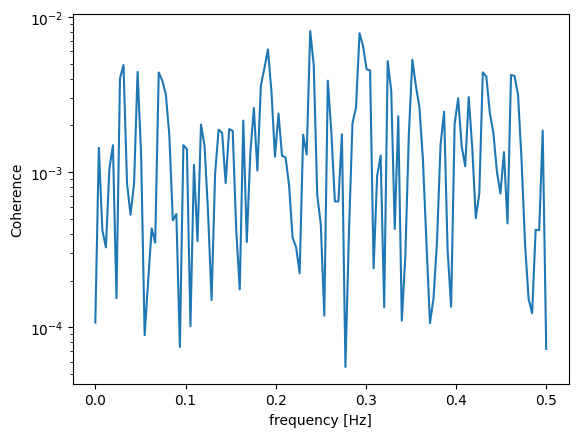

______________________


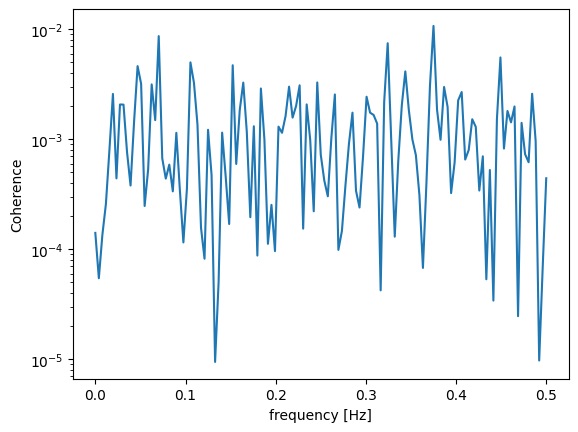

______________________


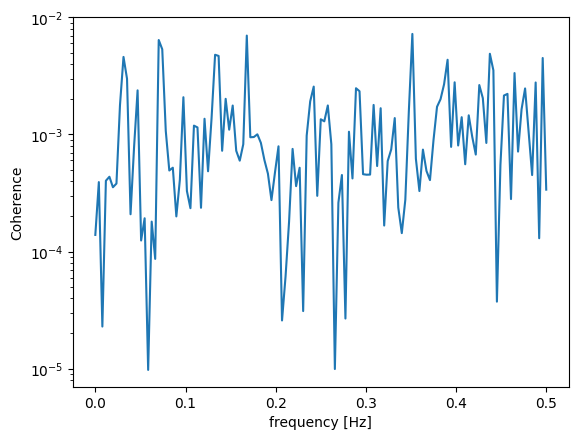

______________________


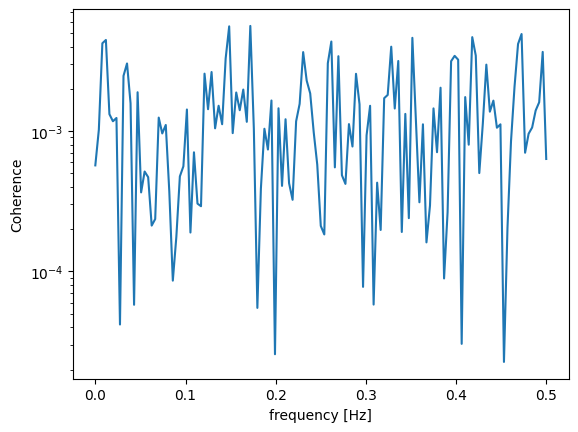

______________________


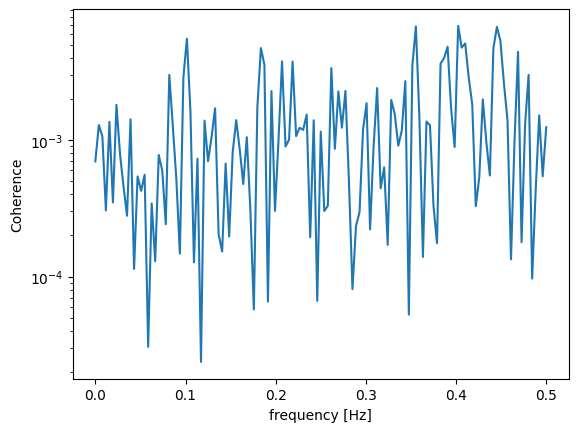

______________________


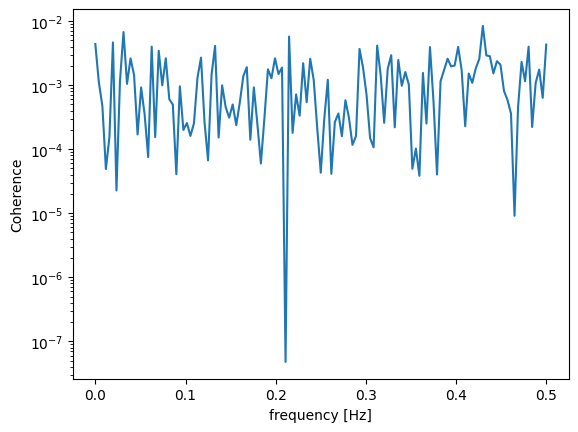

______________________


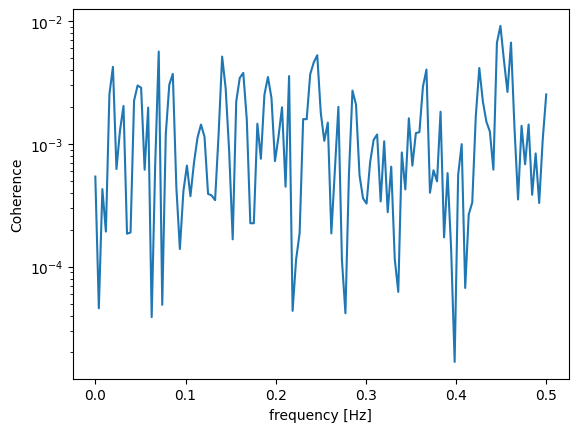

______________________


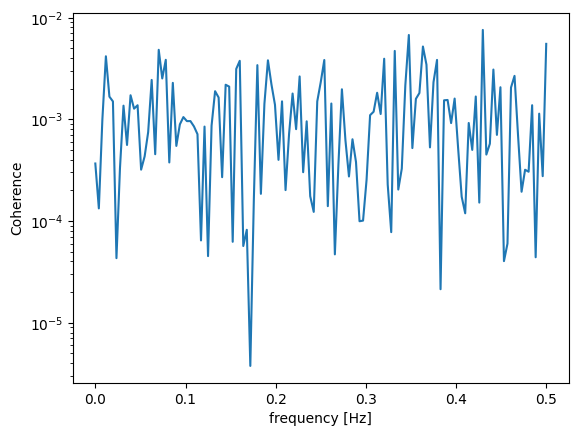

______________________


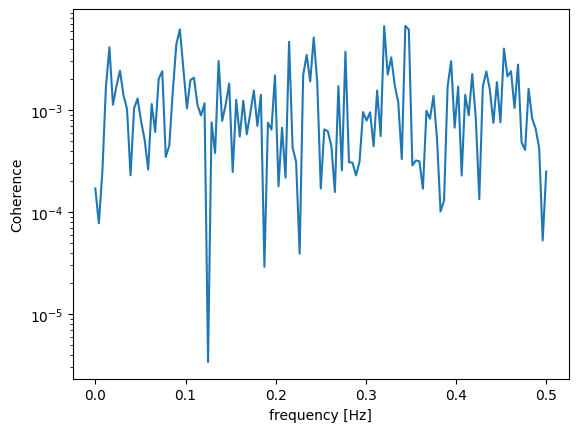

______________________


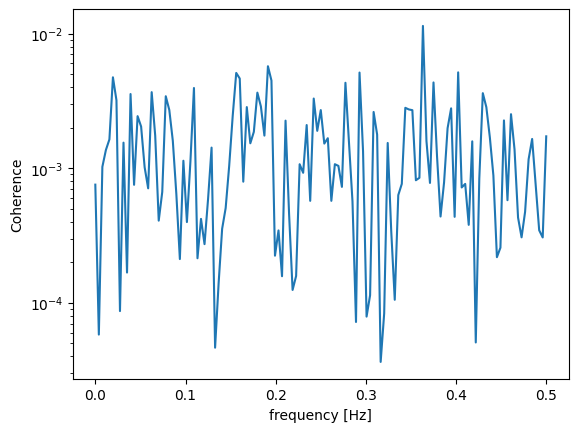

______________________


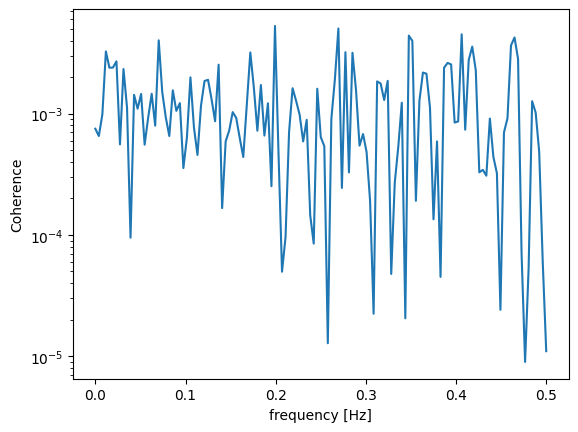

______________________


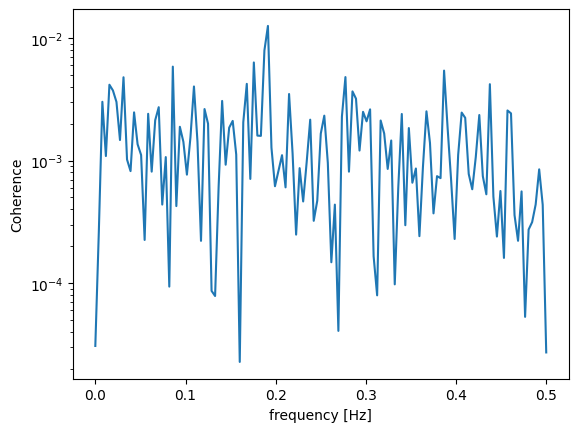

______________________


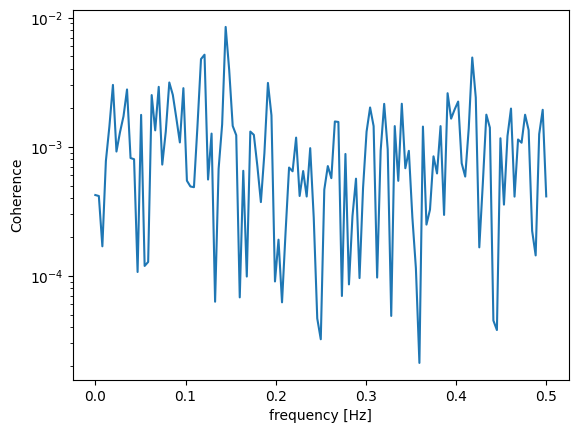

______________________


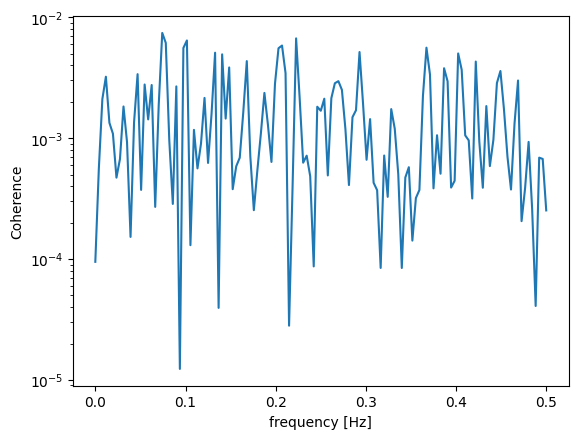

______________________


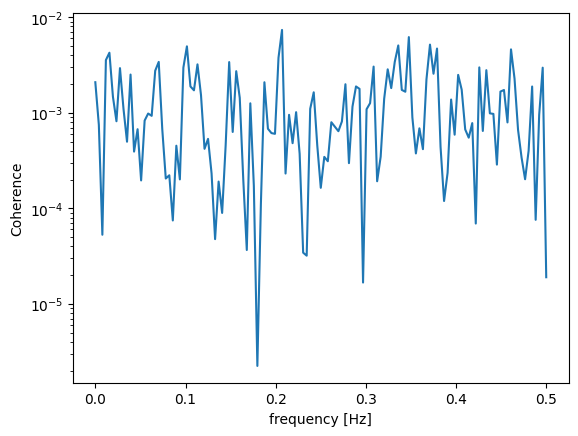

______________________


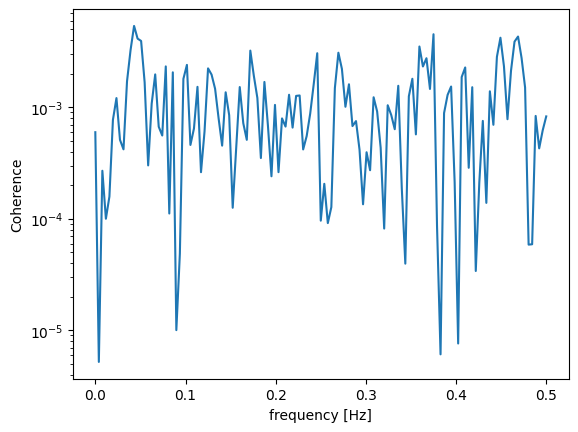

______________________


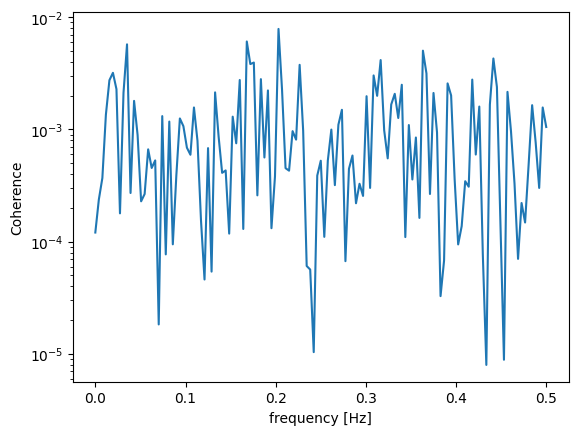

______________________


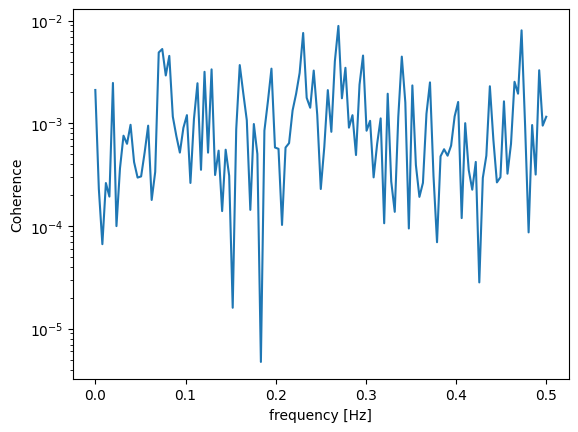

______________________


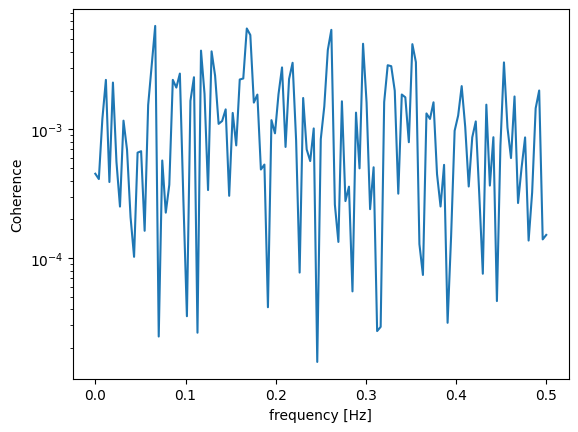

______________________


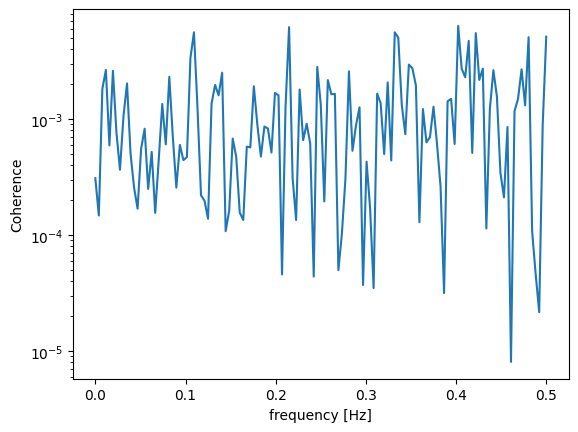

______________________


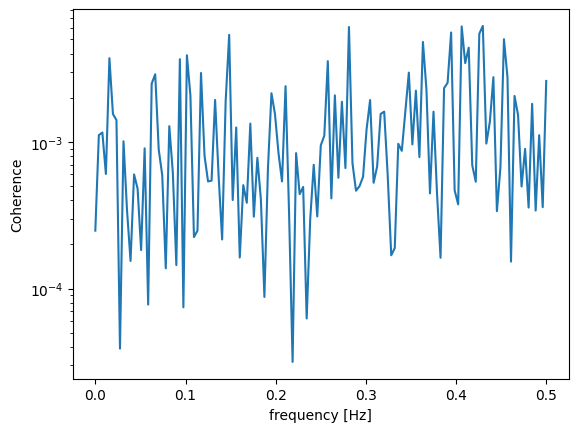

______________________


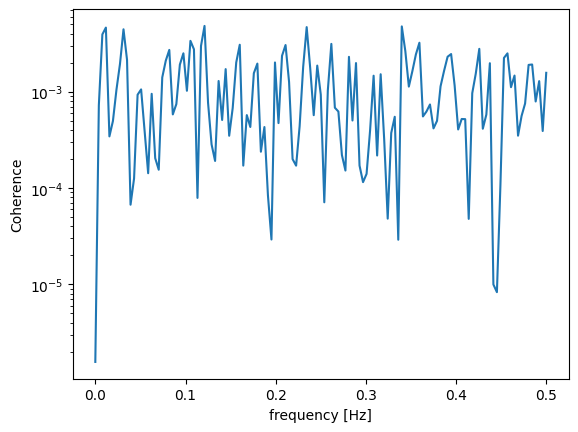

______________________


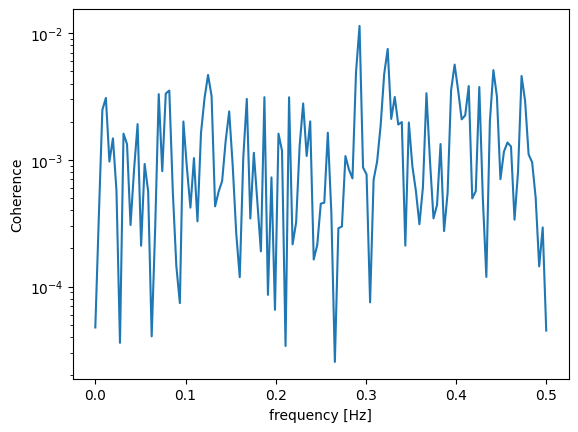

______________________


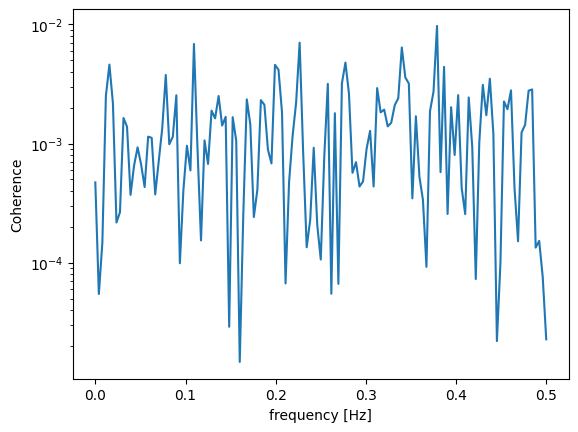

______________________


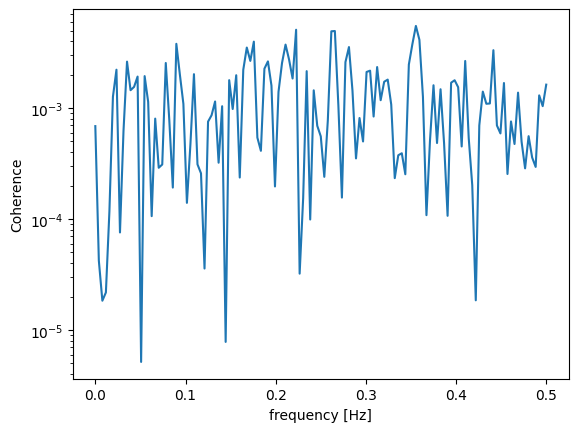

______________________


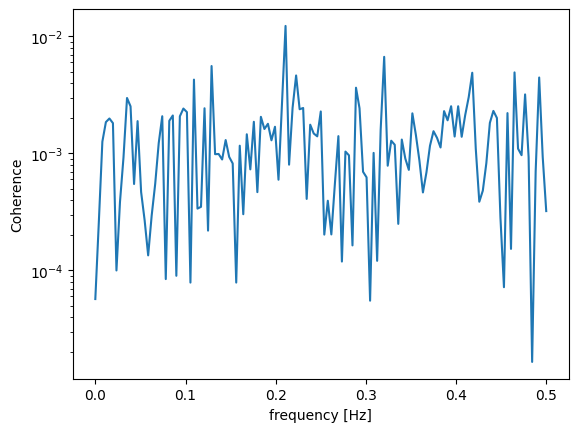

______________________


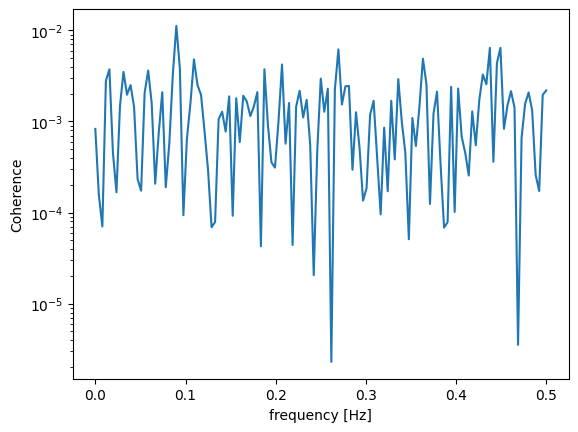

______________________


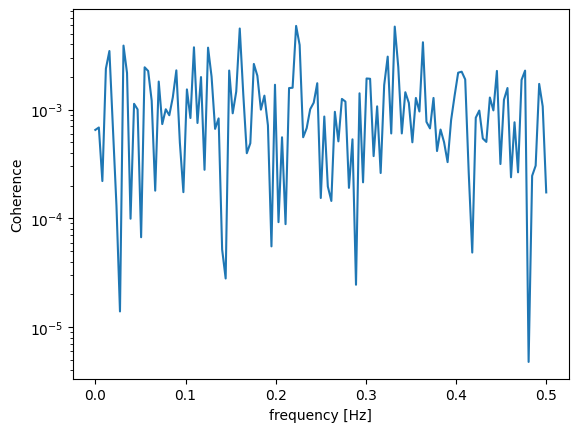

______________________


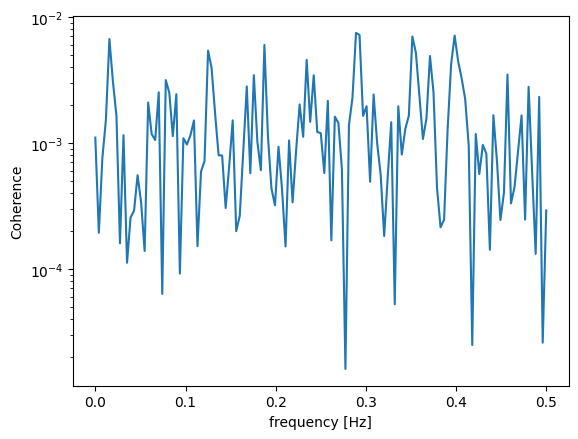

______________________


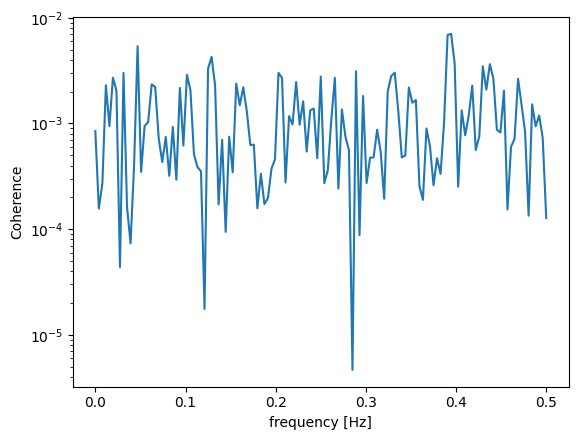

______________________


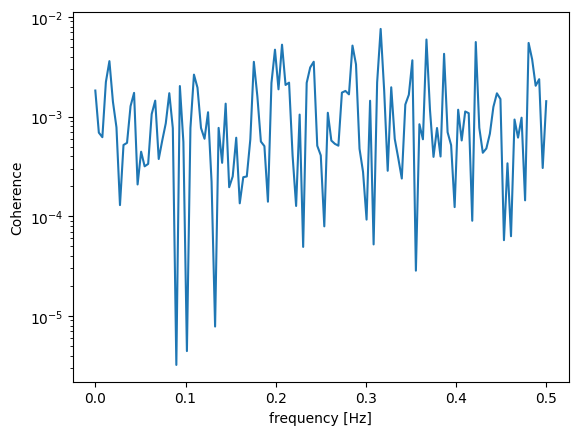

______________________


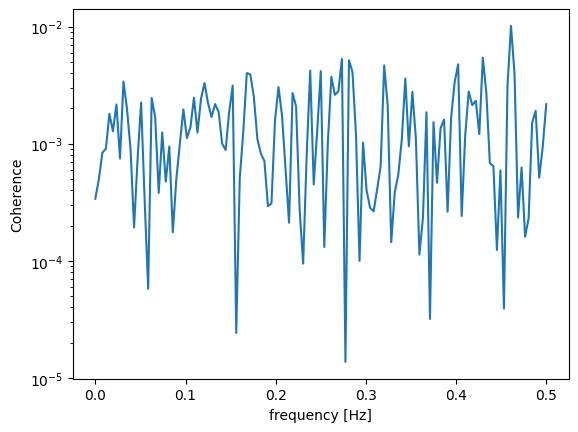

______________________


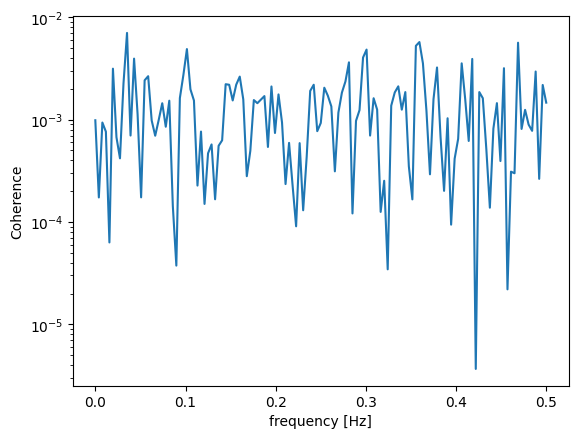

______________________


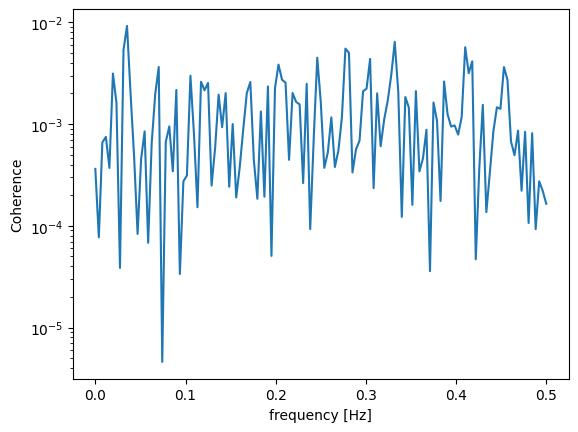

______________________


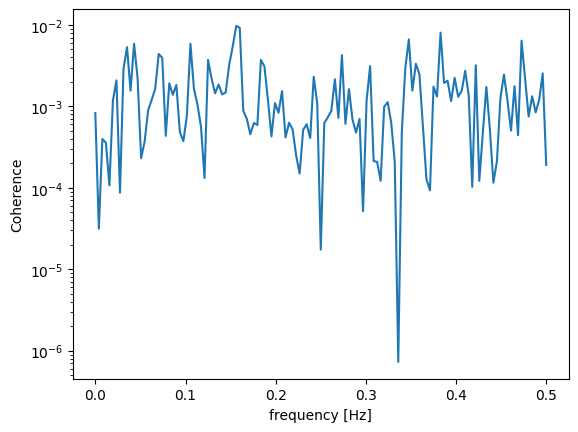

______________________


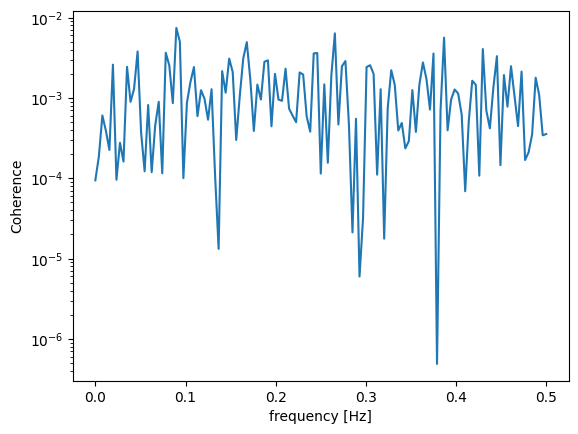

______________________


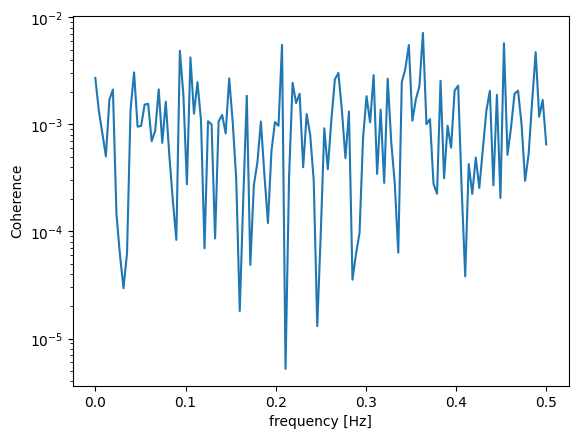

______________________


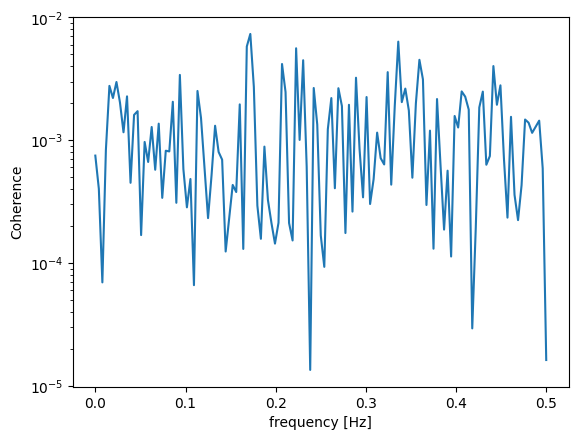

______________________


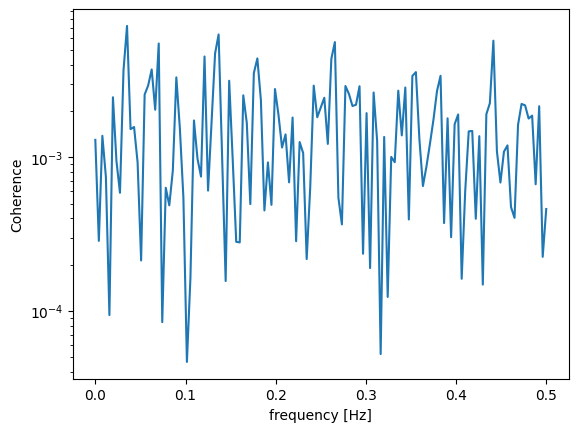

______________________


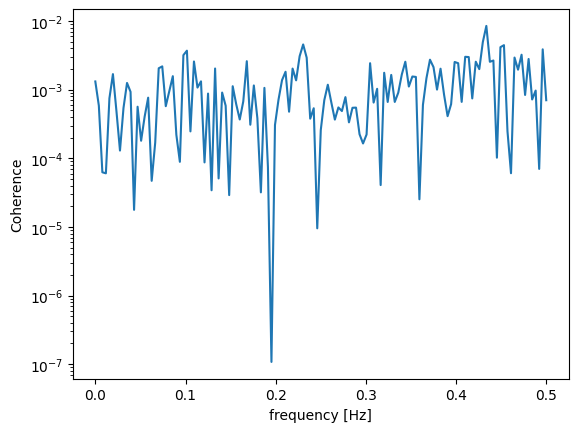

______________________


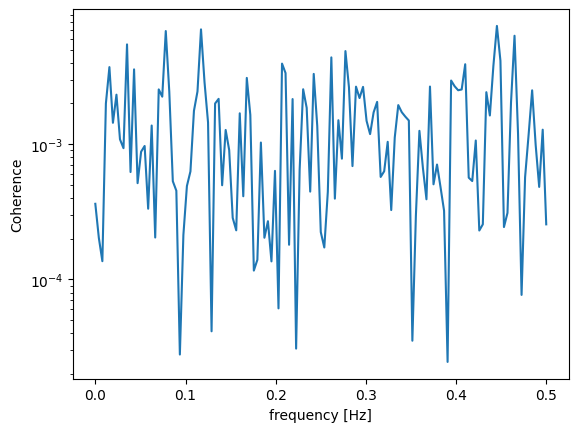

______________________


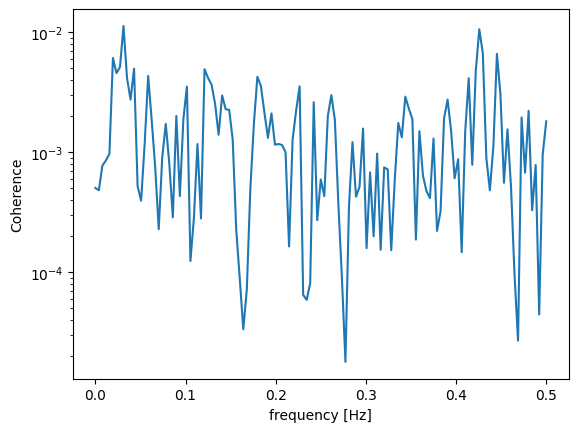

______________________


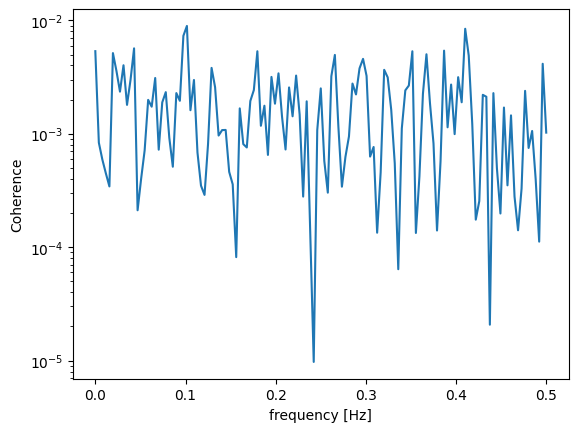

______________________


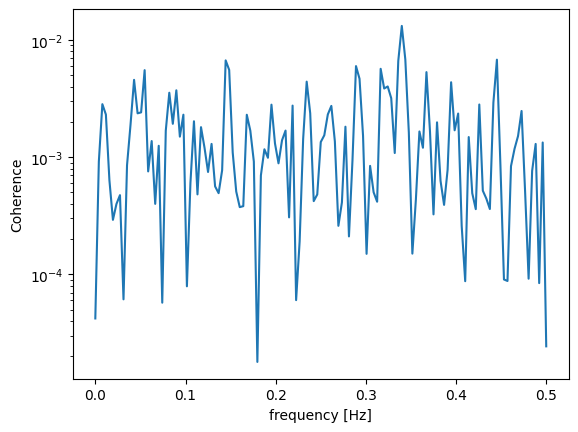

______________________


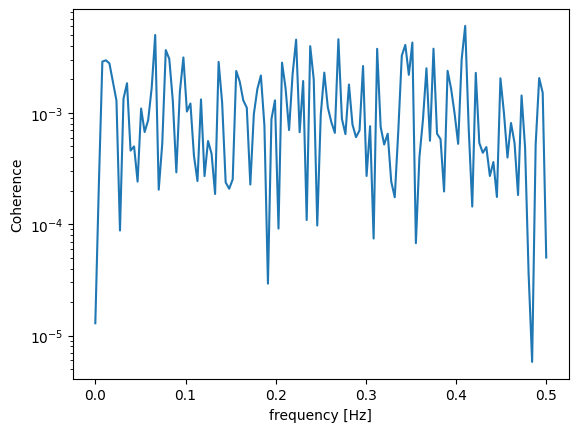

______________________


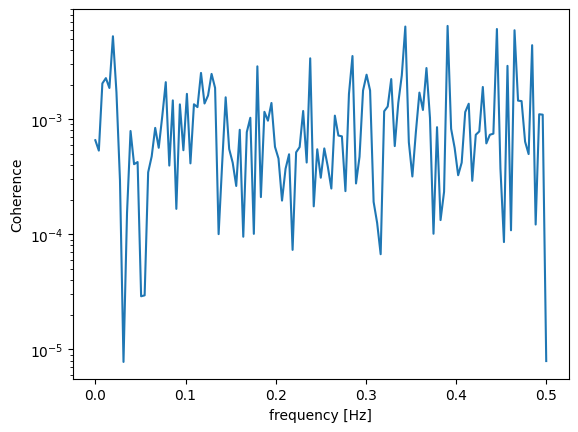

______________________


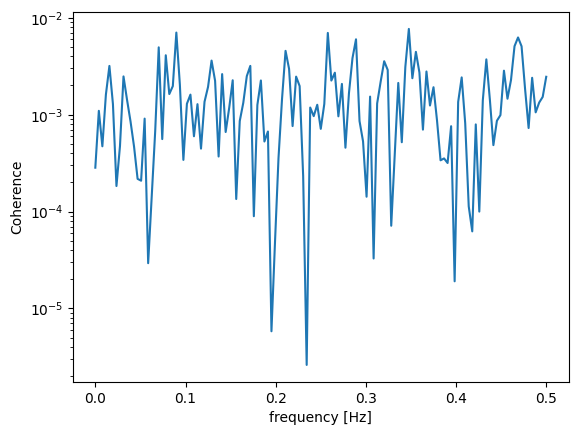

______________________


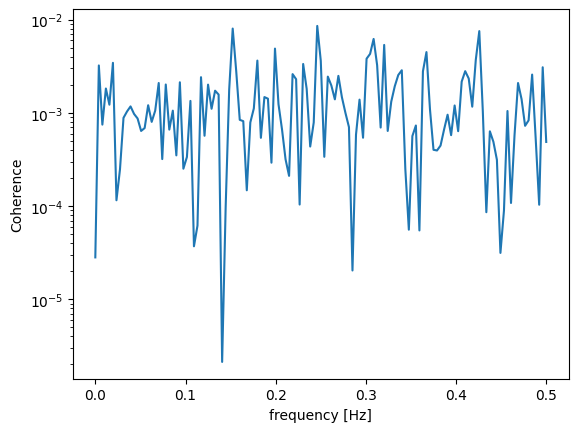

______________________


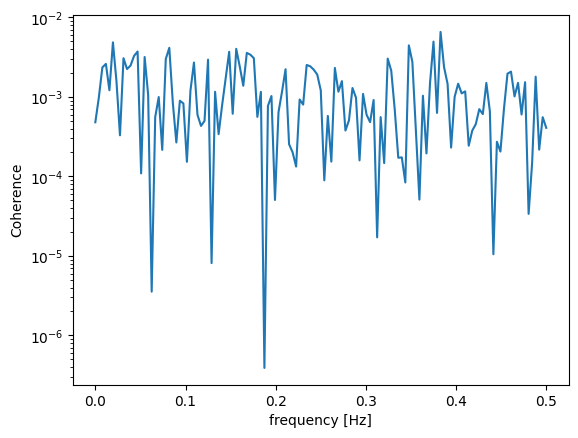

______________________


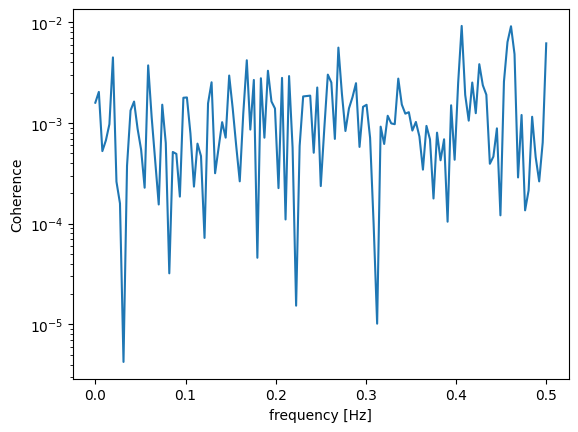

______________________


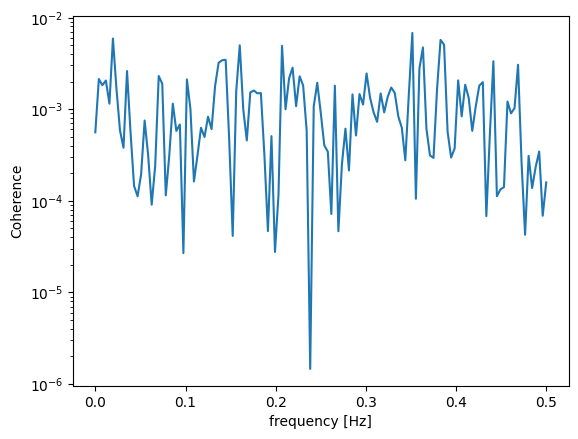

______________________


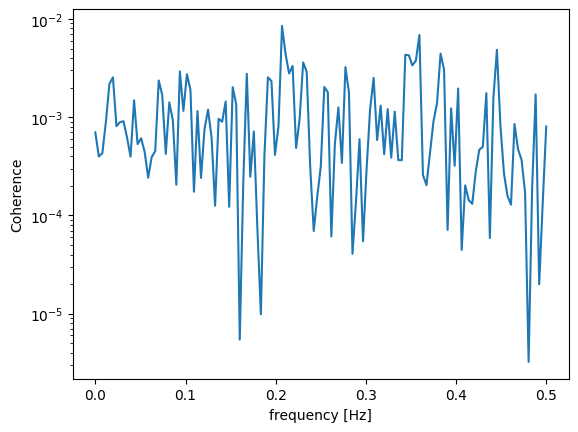

______________________


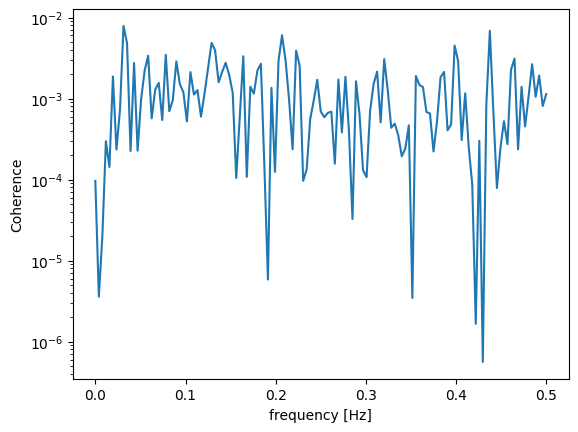

______________________


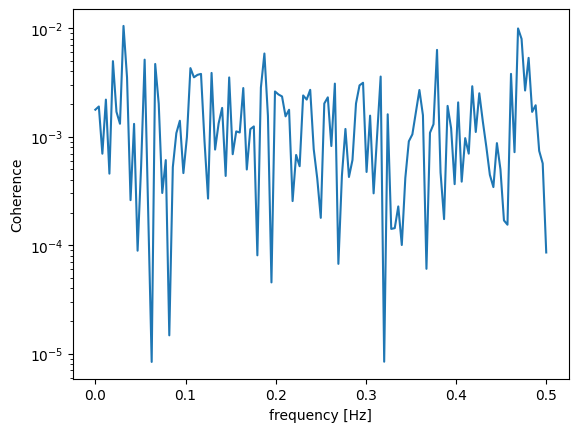

______________________


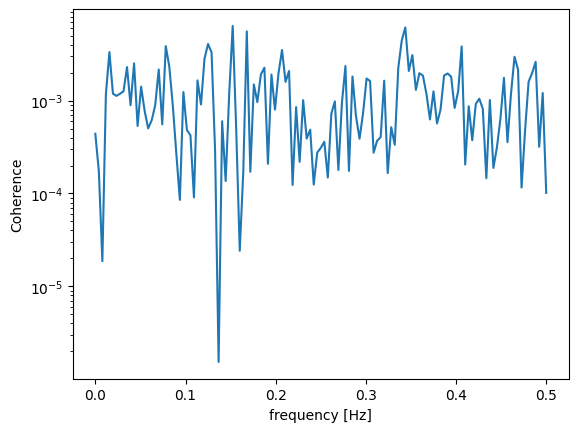

______________________


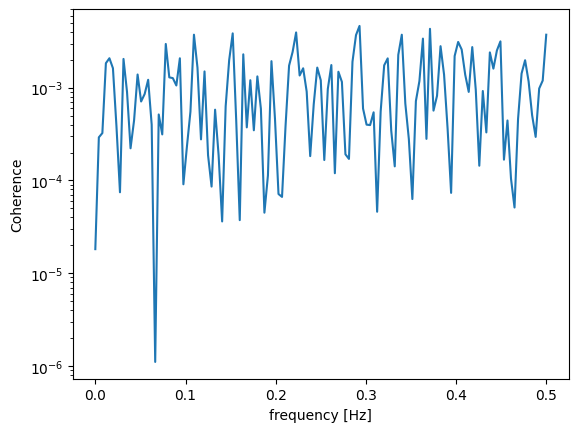

______________________


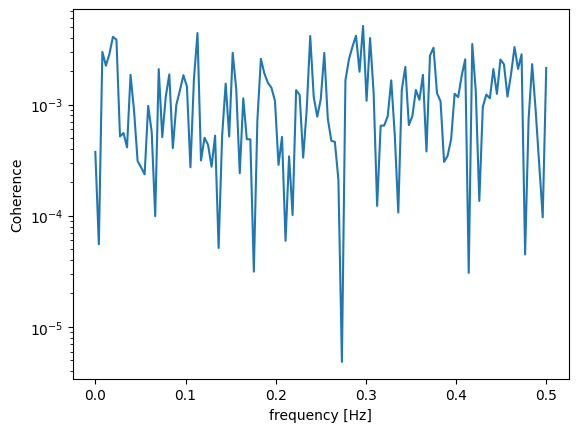

______________________


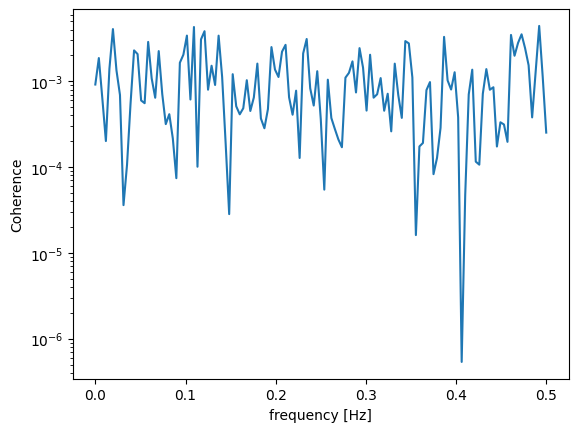

______________________


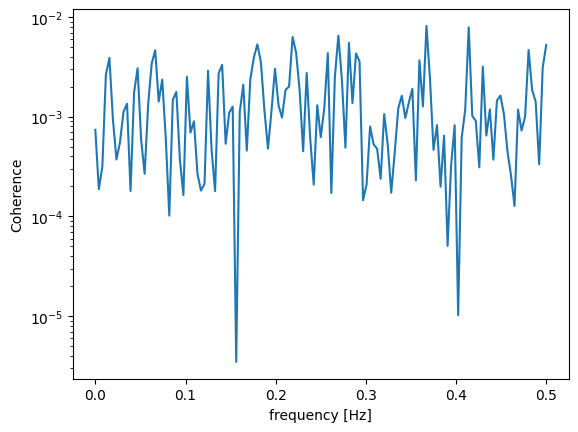

______________________


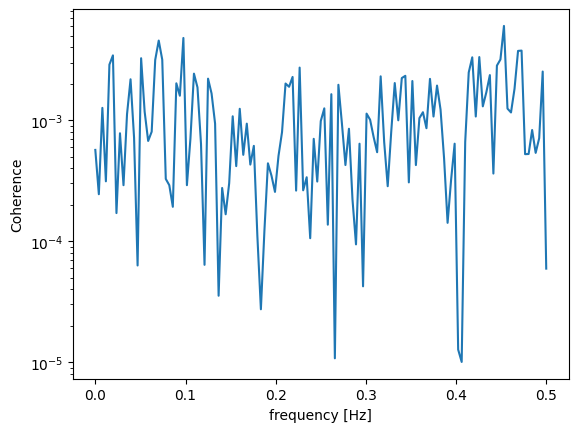

______________________


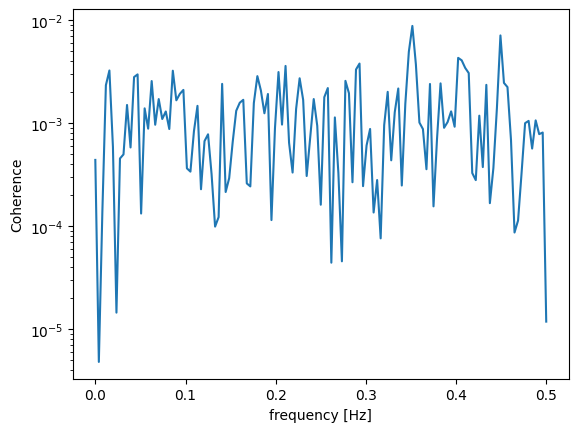

______________________


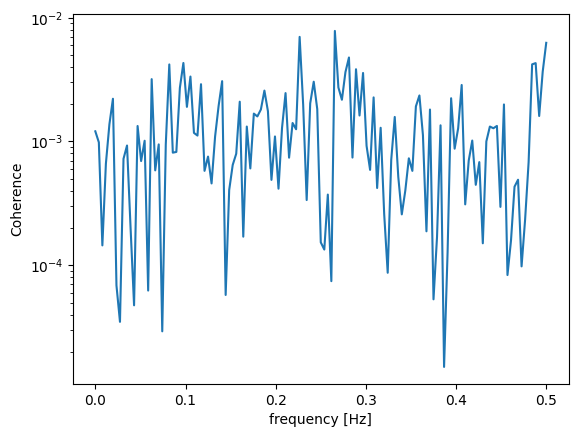

______________________


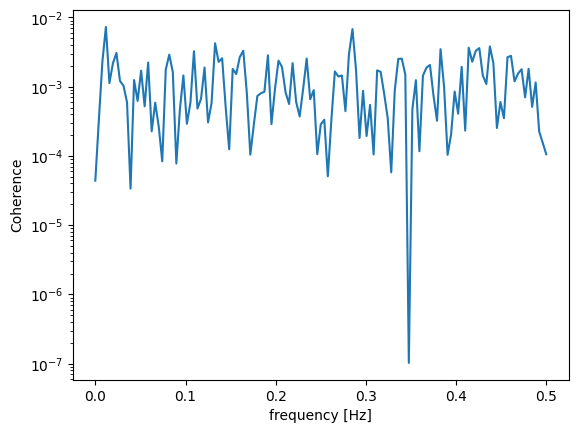

______________________


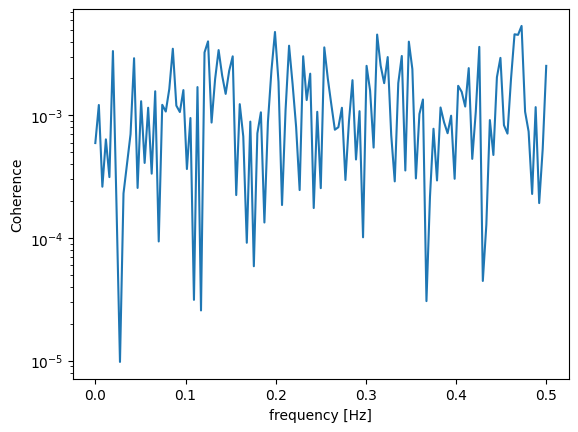

______________________


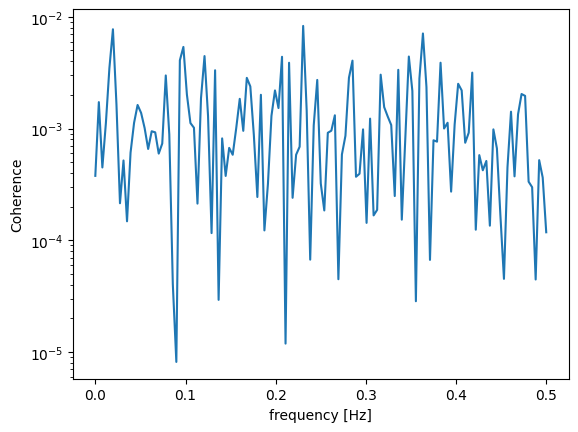

______________________


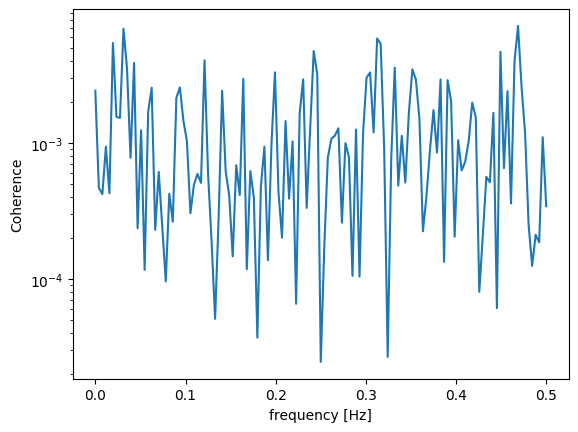

______________________


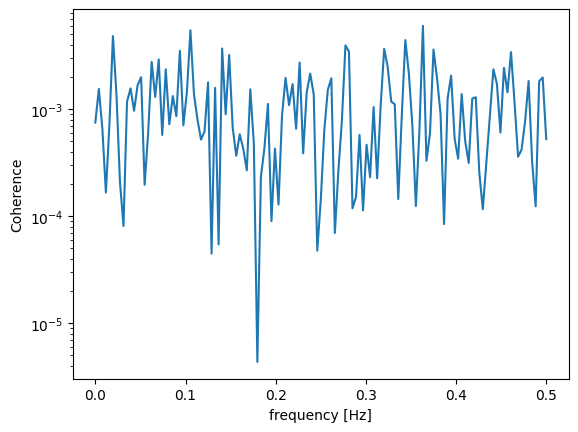

______________________


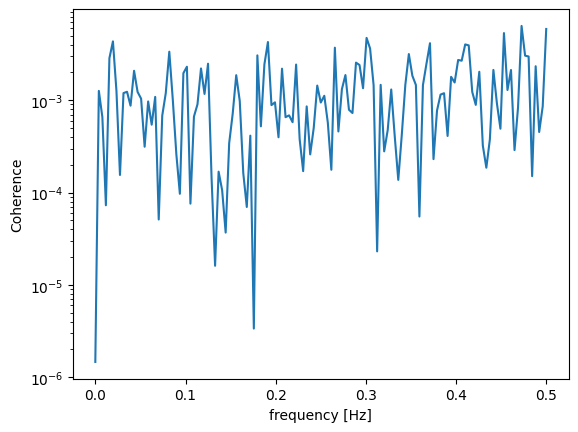

______________________


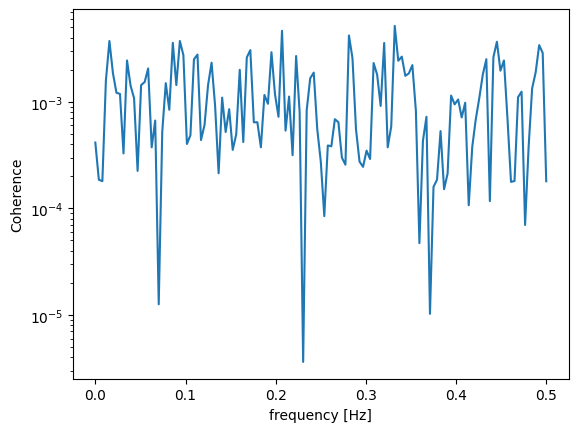

______________________


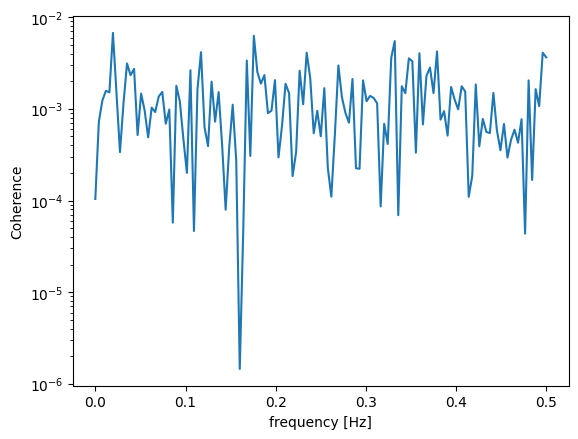

______________________


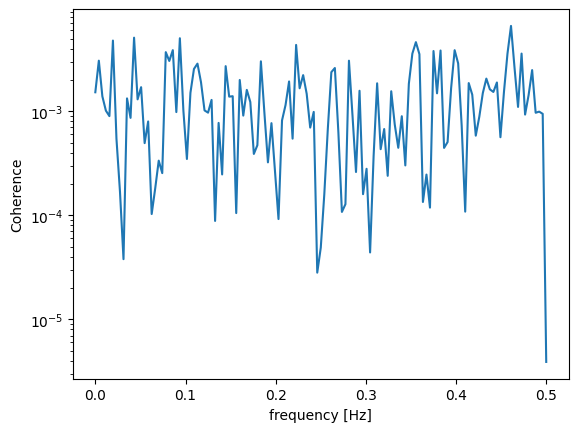

______________________


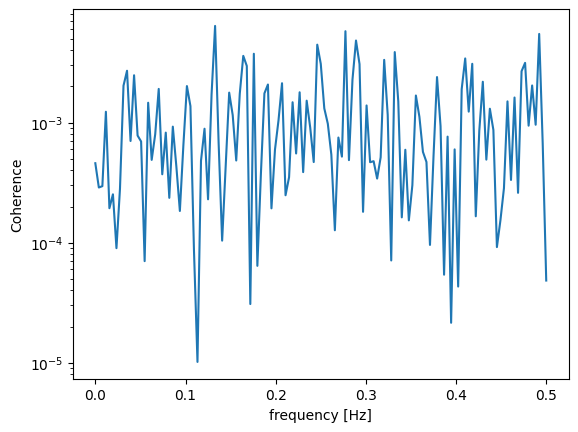

______________________


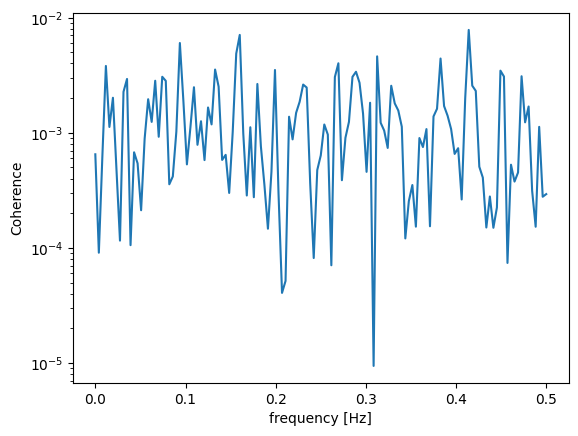

______________________


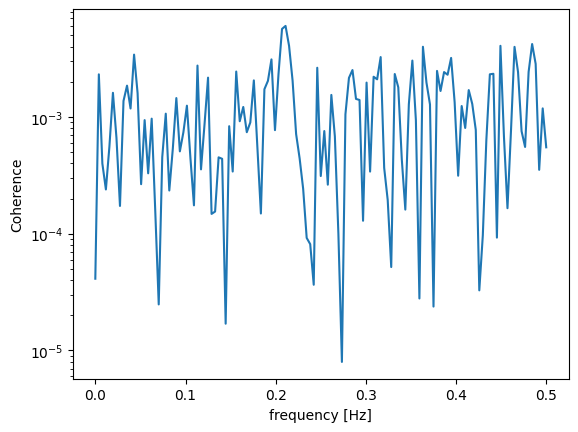

______________________


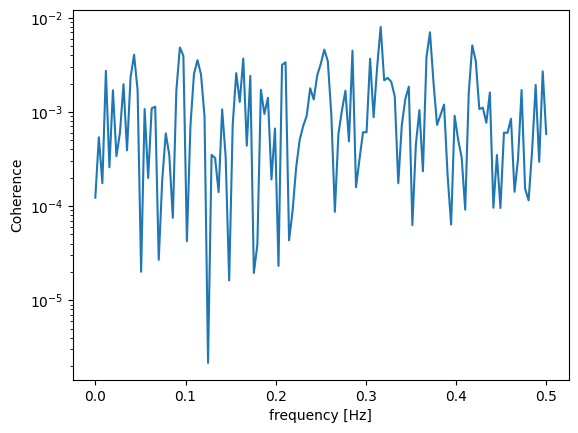

______________________


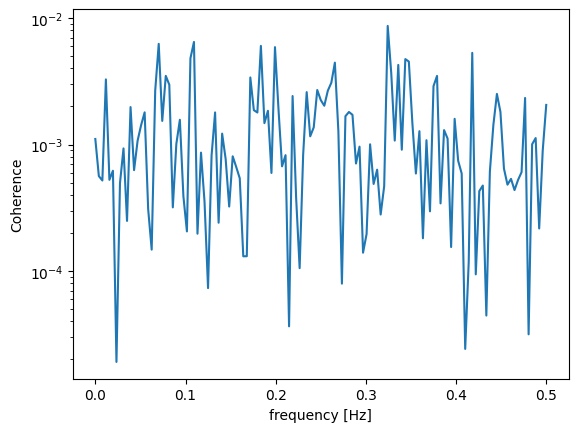

______________________


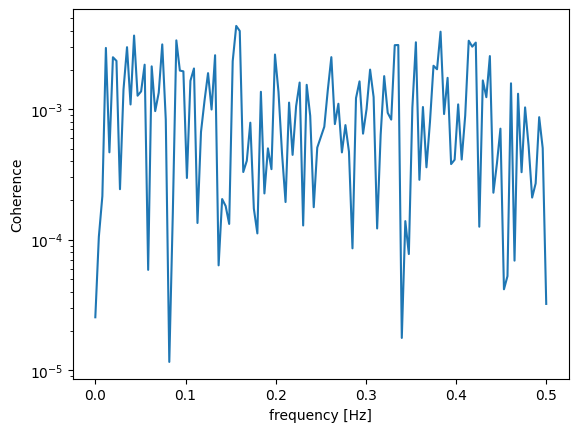

______________________


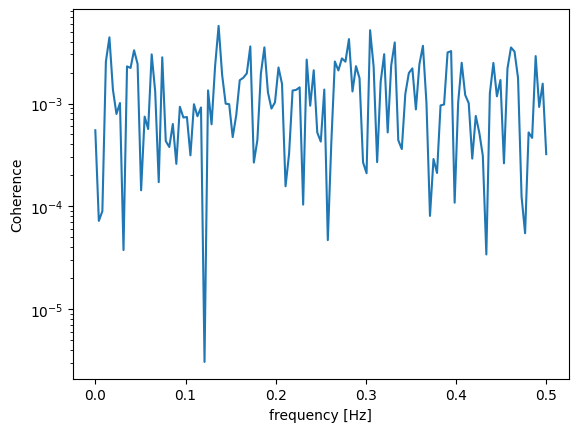

______________________


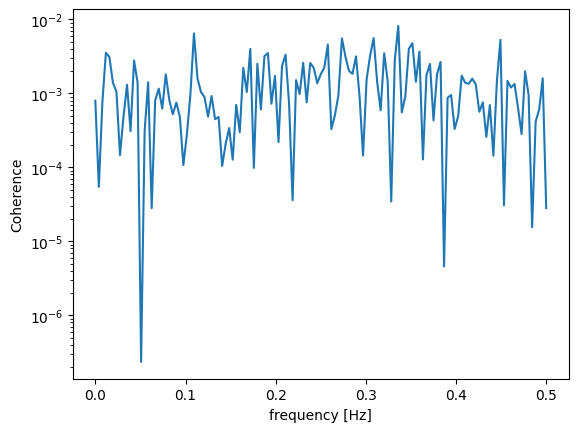

______________________


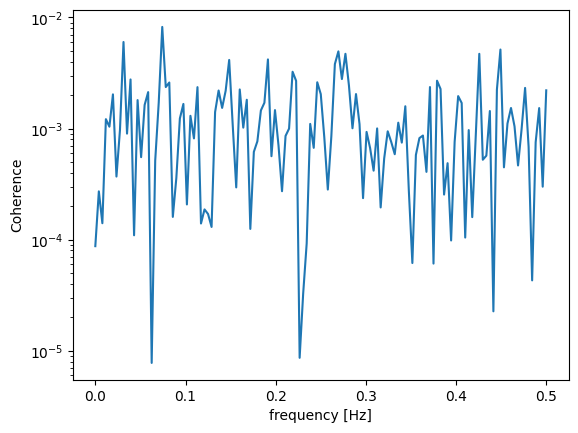

______________________


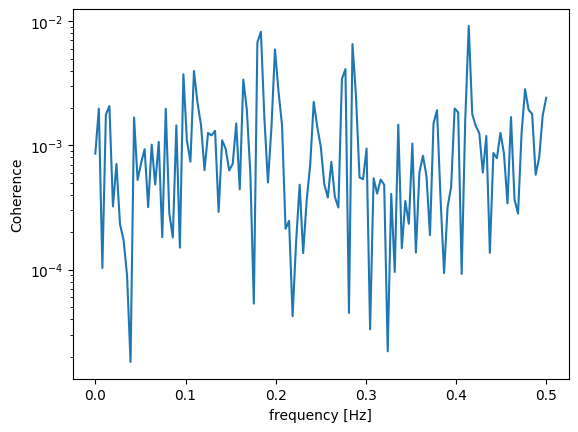

______________________


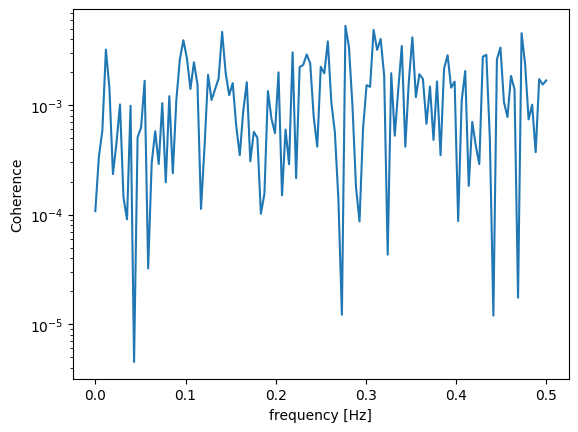

______________________


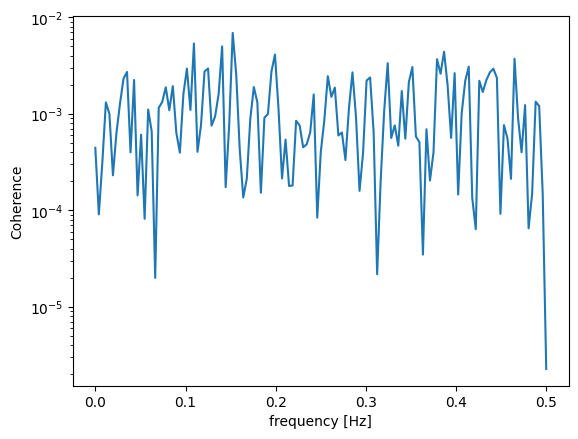

______________________


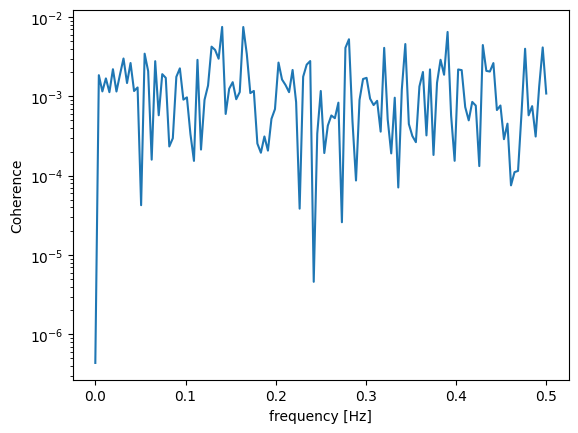

______________________


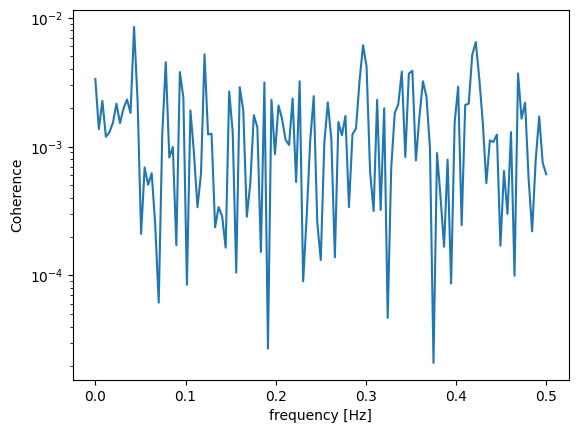

______________________


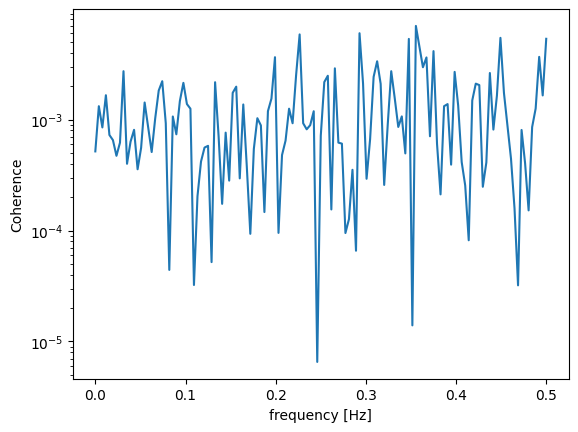

______________________


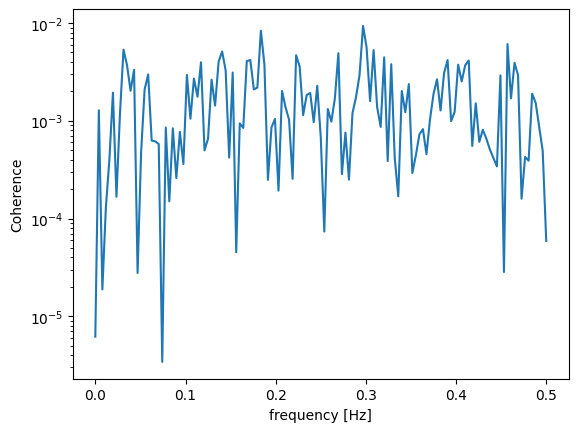

______________________


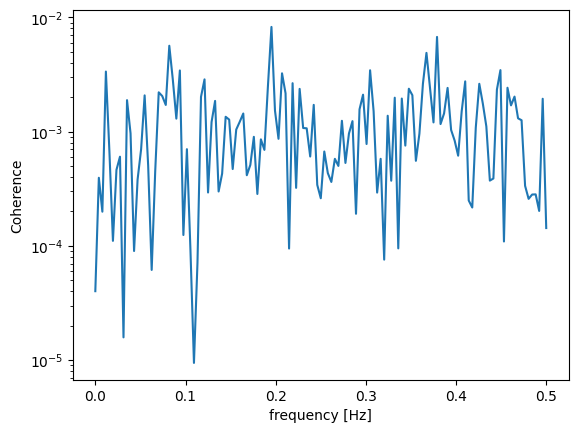

______________________


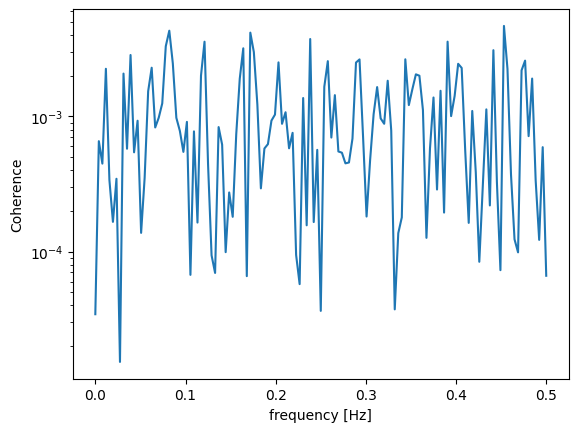

______________________


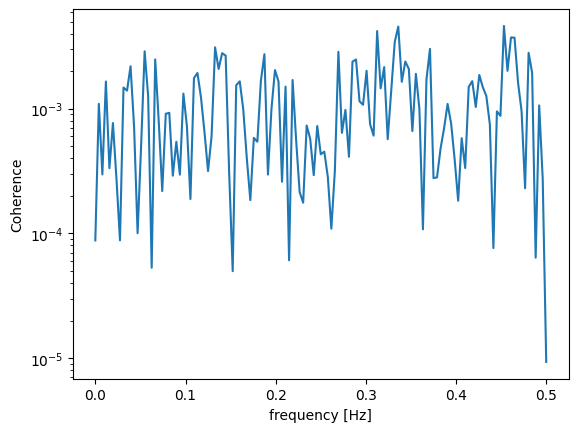

______________________


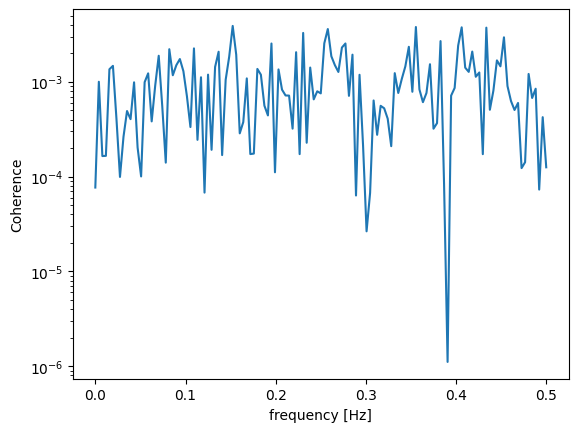

______________________


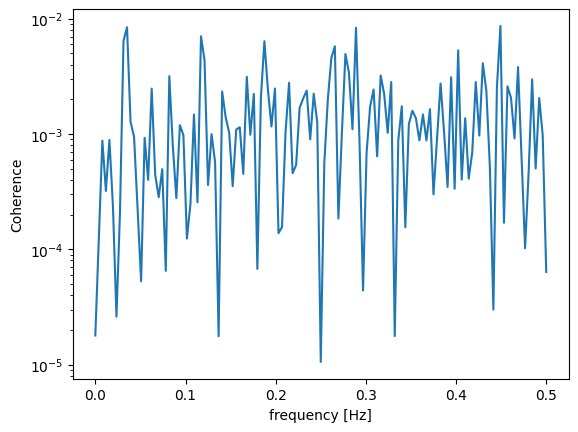

______________________


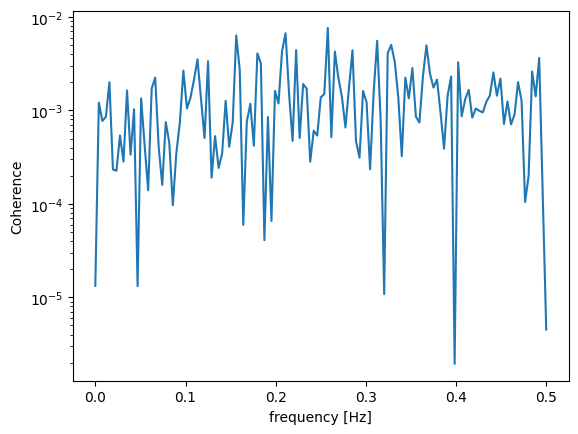

______________________


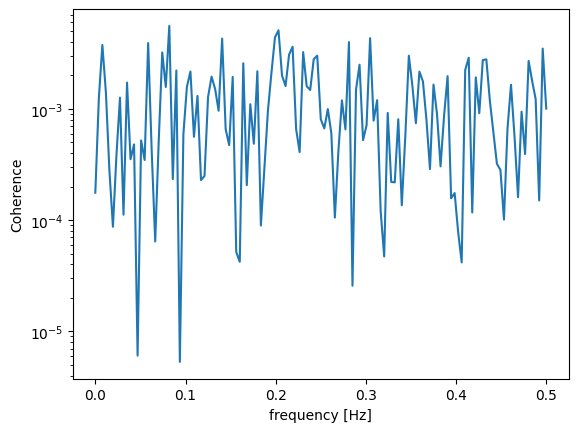

______________________


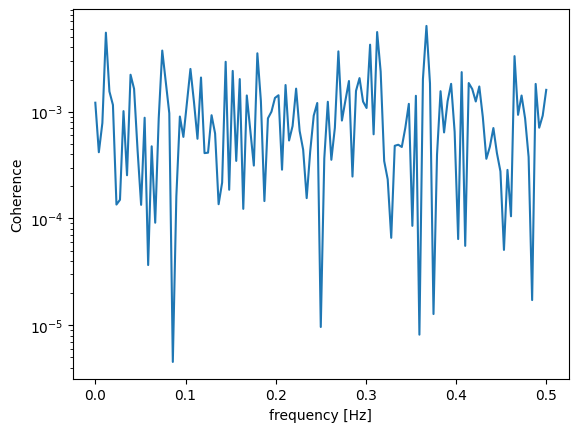

______________________


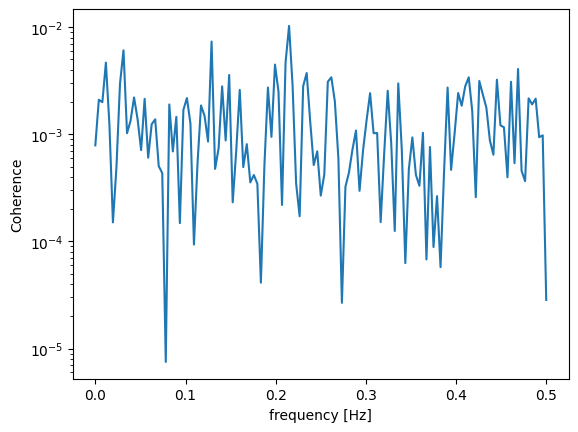

______________________


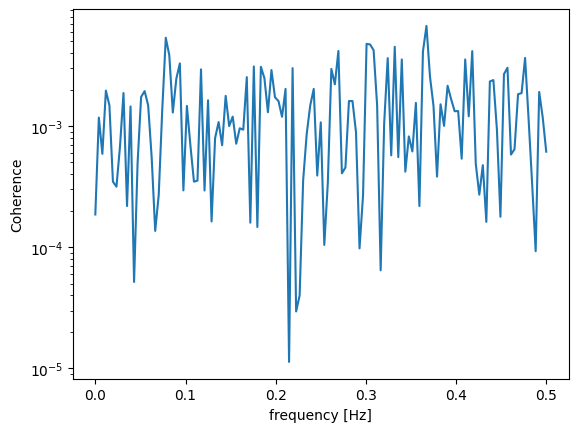

______________________


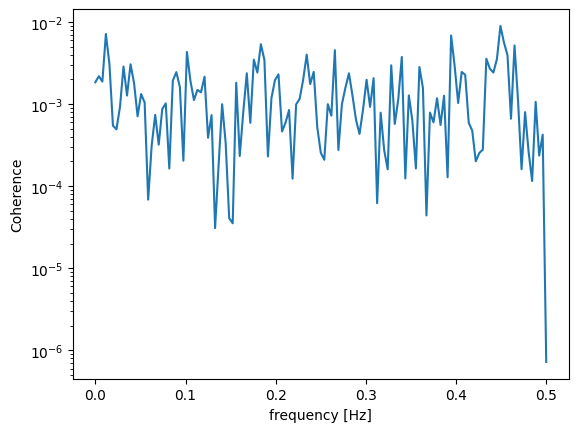

______________________


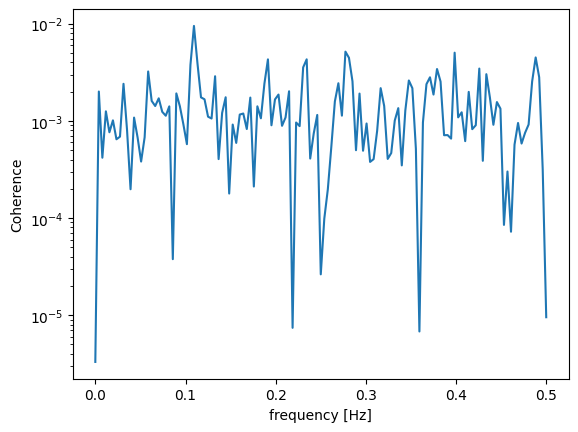

______________________


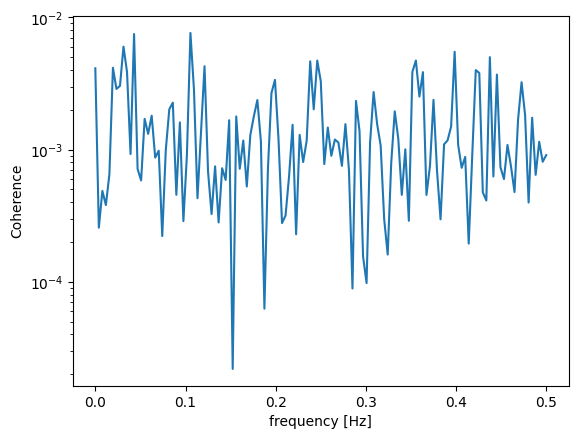

______________________


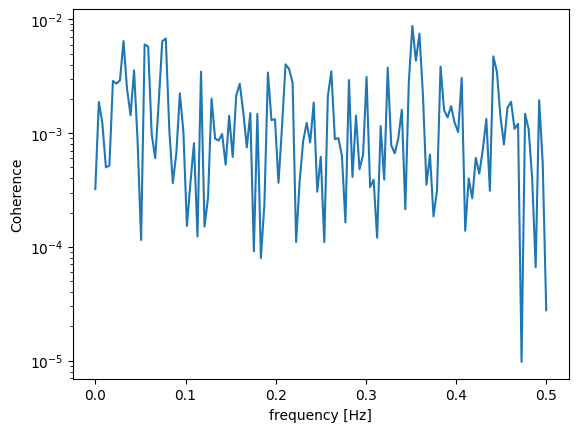

______________________


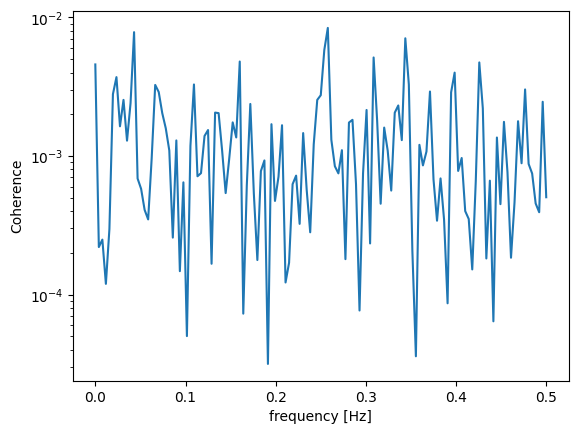

______________________


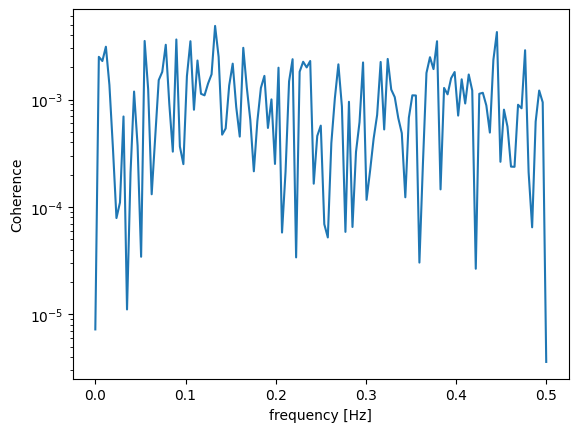

______________________


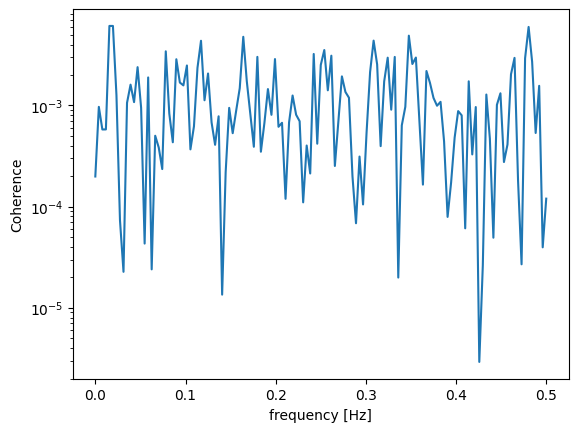

______________________


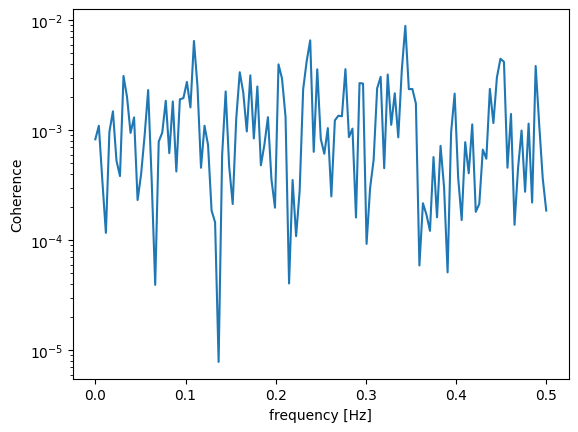

______________________


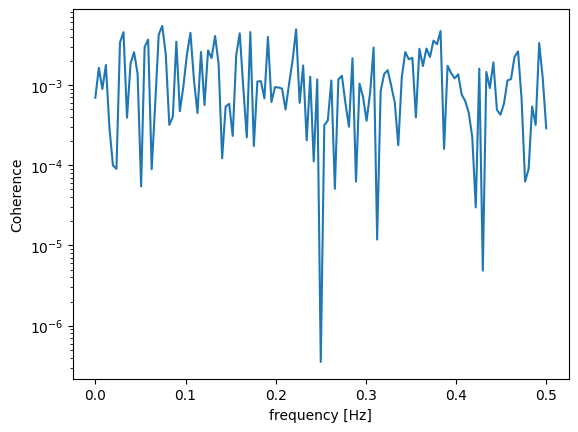

______________________


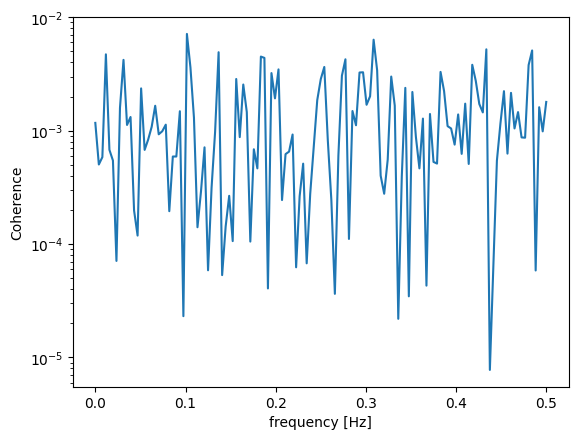

______________________


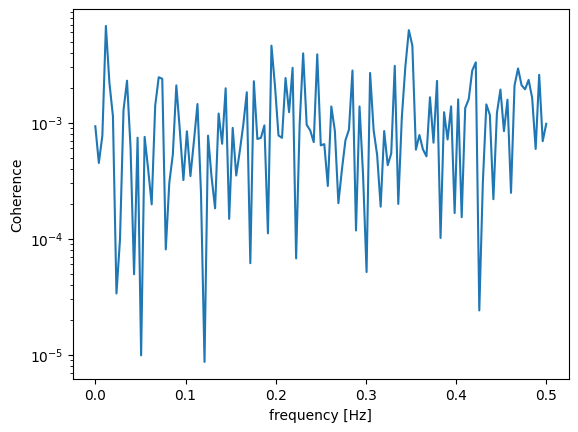

______________________


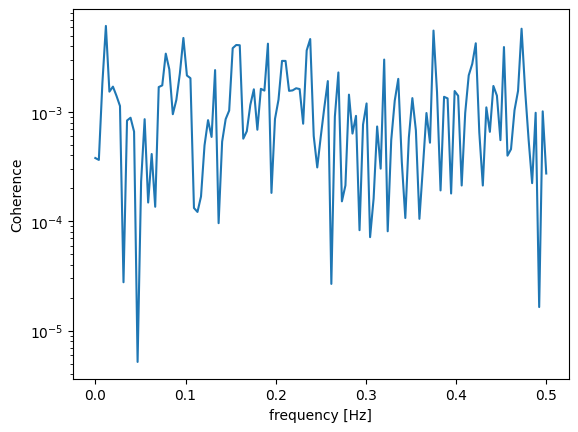

______________________


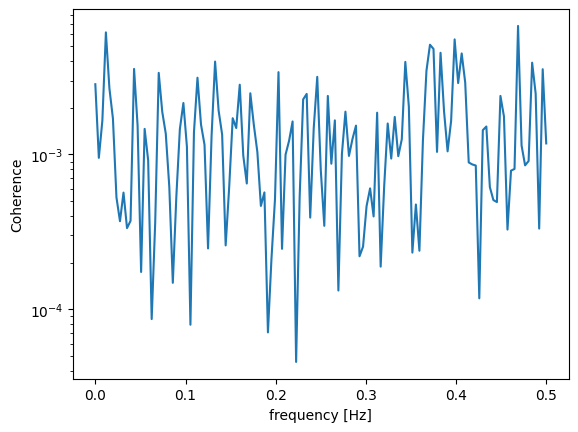

______________________


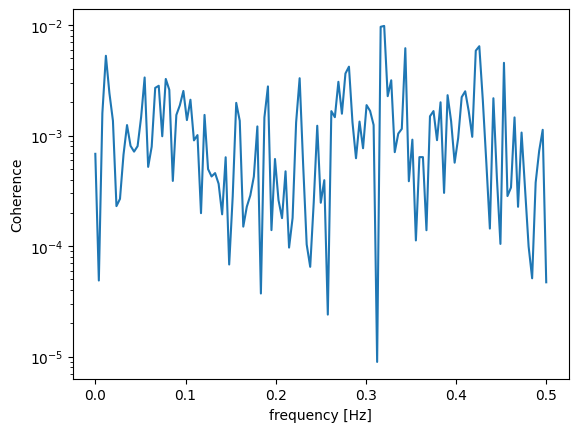

______________________


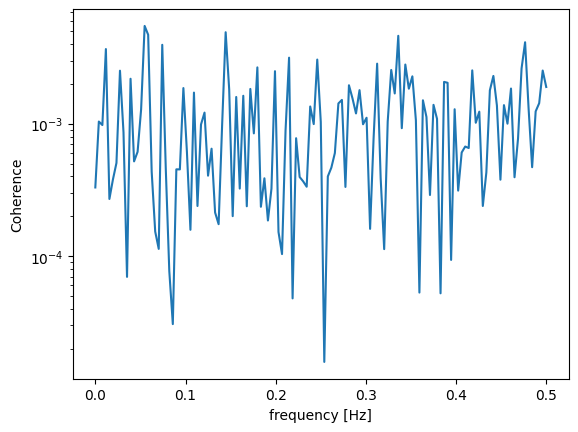

______________________


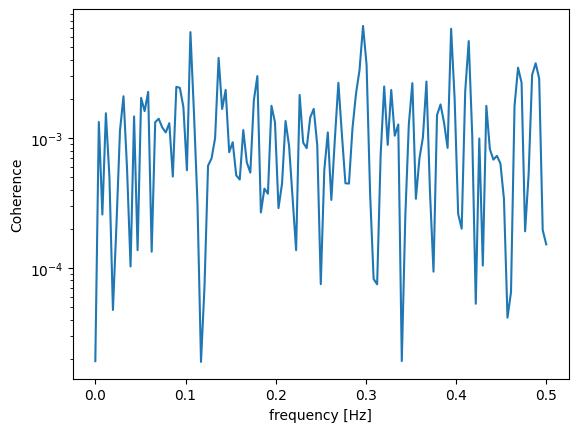

______________________


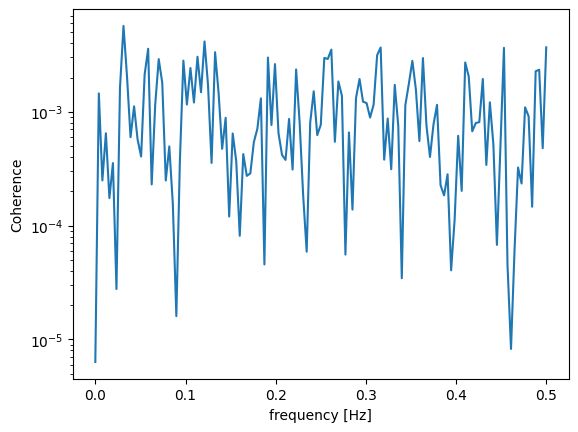

______________________


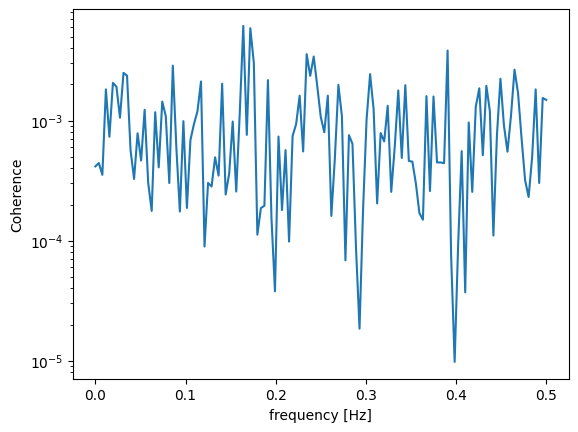

______________________


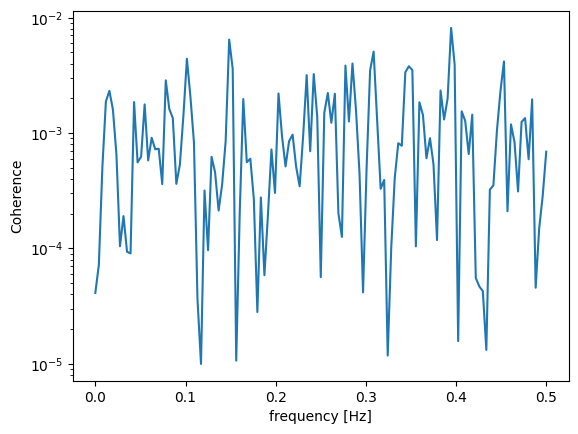

______________________


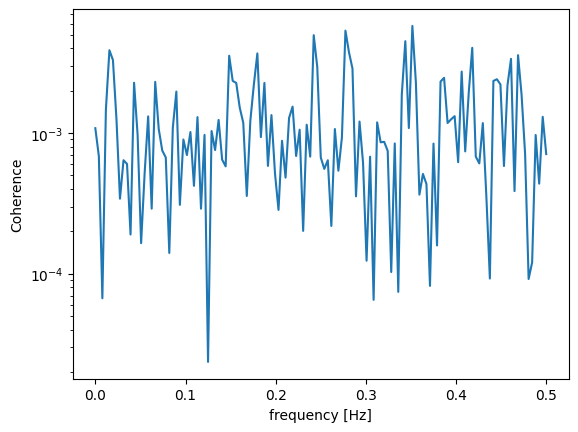

______________________


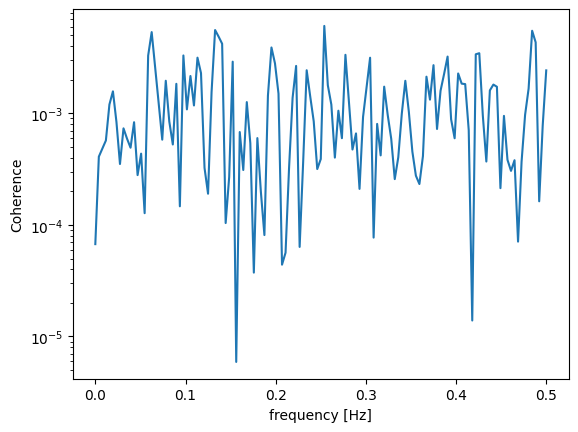

______________________


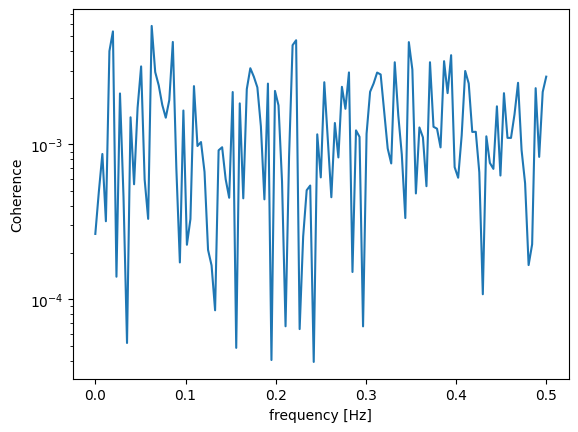

______________________


In [41]:
for i in range(brain_activity.shape[0]):
    cohh_brain, Cxyndarray =coherence(speech1000,brain_activity[i, 23506:23506+speech1000.shape[0]])
    plt.semilogy(cohh_brain, Cxyndarray)
    plt.xlabel('frequency [Hz]')
    plt.ylabel('Coherence')
    plt.show()
    print('______________________')


In [42]:
##  Разобьем сигнал на кусочки по 3 секунды

In [43]:
all_brain_when_listening =brain_activity[:, 23506:23506+speech1000.shape[0]]

In [44]:
def calculate_correlation_on_all_segments(speech, brain_activity, time):
    brain_correlations = []
    for i in range(0,brain_activity.shape[0], time):
        brain_correlations.append(pearsonr(speech[i: i+time],brain_activity[i: i+time])[0])
    return brain_correlations    

In [45]:
brain_correlations =calculate_correlation_on_all_segments(speech1000, brain_activity[0, 23506:23506+speech1000.shape[0]], 3000)

In [46]:
np.mean(brain_correlations)

-0.00014107866764123

In [47]:
brain_correlations =calculate_correlation_on_all_segments(speech1000, brain_activity[0, 23506:23506+speech1000.shape[0]], 4000)

In [48]:
np.mean(brain_correlations)

-0.0001532932032174726

In [49]:
brain_correlations =calculate_correlation_on_all_segments(speech1000[0:-150], brain_activity[0, 23506+150:23506+speech1000.shape[0]], 3000)

In [50]:
np.mean(brain_correlations)

0.0013812942386806947

In [25]:
brain_correlations =calculate_correlation_on_all_segments(speech1000[0:-300], brain_activity[0, 23506+300:23506+speech1000.shape[0]], 1000)

NameError: name 'calculate_correlation_on_all_segments' is not defined

In [84]:
np.mean(brain_correlations)

0.001579180760072028

In [94]:
TIME=1000

In [95]:
all_corr =0
for i in range(brain_activity.shape[0]):
    brain_correlations =calculate_correlation_on_all_segments(speech1000[0:-150], brain_activity[i, 23506+150:23506+speech1000.shape[0]], TIME)
    correlation =np.mean(brain_correlations)
    all_corr+=correlation
    if correlation>0.0:
        print(correlation)

0.001579180760072028
0.0005146299271188275
0.0011551194134066958
0.00028462501941057785
0.00023062685212001991
0.0004649650598517509
0.0006013590614871142
0.0006639420090946519
0.0009308916568496341
0.0006751669658327566
0.0006359888086207796
0.0007904356620881027
0.0003592072262442333
0.0007301562413695719
0.0016399269504094045
0.00016755811760388534
0.00042268053832997325
5.082878643992889e-05
0.0003627352803045367
0.0014674120566448765
0.0029044617368007256
0.000614297961916385
0.000873390437766418
2.181382799426377e-05
0.00015887753548788575
0.00039895137601348726
0.00032021377739375117
0.0005616896497761928
0.00036717643119161544
0.001631929481722583
0.000911400690067586
0.001419864023922416
0.0006173872627801623
0.0014820854571280827
0.0008243898984257592
0.0015390705161367566
0.00043017959600768086
0.0018308968302754216
0.0021070780659592616
0.0019179009514787215
0.0006688871922631116
0.0009653241409763228
0.0005876646291805114
0.0006245787137516786
0.0014762098126959403
9.29289

In [97]:
all_corr

0.030091075187137592

In [98]:
def split_groups(speech, brain_activity, time):
    X, y = [], []
    for i in range(0,brain_activity.shape[0], time):
        X.append(brain_activity[i: i+time])
        y.append(speech1000[i: i+time])
    return np.stack(X[:-1]),np.stack(y[:-1])   

In [99]:
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.linear_model import Ridge

In [100]:
brain_activity[0, 23506:23506+speech1000.shape[0]].shape

(95882,)

In [101]:
speech1000

array([ 2.6133031e-05, -4.3832159e-05,  7.0769209e-05, ...,
        6.7335950e-09, -4.0591789e-08,  1.2433283e-08], dtype=float32)

In [132]:
X,y =split_groups(speech1000[0:-150], brain_activity[2, 23506+150:23506+speech1000.shape[0]], TIME)

In [133]:
X

array([[ 4.94048915e-13,  5.31354650e-13,  4.87999337e-13, ...,
         4.21453972e-13,  3.35751610e-13,  3.55916871e-13],
       [ 4.73883653e-13,  4.67834075e-13,  3.11553295e-13, ...,
         8.97354152e-14,  1.18975045e-13,  2.18793091e-13],
       [ 3.18611137e-13,  2.50049247e-13,  2.09718723e-13, ...,
        -9.17519414e-14,  3.22644189e-14,  1.64346884e-13],
       ...,
       [-2.54082299e-13, -3.22644189e-13, -4.31536603e-13, ...,
         1.06875888e-13,  1.26032887e-13,  1.91569987e-13],
       [ 2.53074036e-13,  3.46842504e-13,  5.72693436e-13, ...,
         2.06693934e-13,  2.56098825e-13,  3.30710294e-13],
       [ 3.92214343e-13,  3.40792925e-13,  1.88545198e-13, ...,
         4.49685339e-13,  4.23470499e-13,  4.78924969e-13]])

In [134]:
y

array([[ 2.61330315e-05, -4.38321586e-05,  7.07692088e-05, ...,
         2.59205795e-08, -4.08377154e-08,  5.40208838e-08],
       [-9.23739094e-08,  7.40356114e-08, -9.85691031e-08, ...,
        -1.89049661e-01,  4.59837079e-01, -1.08130127e-02],
       [-4.37532127e-01,  1.89431861e-01,  3.44470203e-01, ...,
        -1.19985536e-01, -1.83257505e-01, -3.12156528e-01],
       ...,
       [-1.85380936e-01, -2.65149117e-01, -1.72100276e-01, ...,
        -6.85380995e-02,  1.73778851e-02,  5.53810000e-02],
       [ 1.86628960e-02,  2.64089610e-02, -3.24960202e-02, ...,
         2.40699232e-01,  5.87816611e-02, -2.58040100e-01],
       [-1.88011214e-01,  2.44728208e-01,  1.91429257e-01, ...,
        -1.40949294e-01,  1.46417707e-01,  3.46287191e-01]], dtype=float32)

In [162]:
TIME=3000

In [175]:
for i in range(brain_activity.shape[0]):
    print(i)
    X,y =split_groups(speech1000[0:-150], brain_activity[i, 23506+150:23506+speech1000.shape[0]], TIME)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    reg = linear_model.ElasticNet(alpha=100,l1_ratio=1)
    reg.fit(X_train,y_train)
    y_predicted =reg.predict(X_test)
    mean_corr =0
    for i in range(y_test.shape[0]):
        mean_corr=pearsonr(y_test[i,:],y_predicted[i,:])[0]
    mean_corr =mean_corr/ y_test.shape[0]
    print(mean_corr)
    print("_______________________")

0
0.001125184910902386
_______________________
1
0.001125184910902386
_______________________
2
0.001125184910902386
_______________________
3
0.001125184910902386
_______________________
4
0.001125184910902386
_______________________
5
0.001125184910902386
_______________________
6
0.001125184910902386
_______________________
7
0.001125184910902386
_______________________
8
0.001125184910902386
_______________________
9
0.001125184910902386
_______________________
10
0.001125184910902386
_______________________
11
0.001125184910902386
_______________________
12
0.001125184910902386
_______________________
13
0.001125184910902386
_______________________
14
0.001125184910902386
_______________________
15
0.001125184910902386
_______________________
16
0.001125184910902386
_______________________
17
0.001125184910902386
_______________________
18
0.001125184910902386
_______________________
19
0.001125184910902386
_______________________
20
0.001125184910902386
_______________________
21

In [ ]:
TIME=3000

In [165]:
for i in range(brain_activity.shape[0]):
    print(i)
    X,y =split_groups(speech1000, brain_activity[i, 23506:23506+speech1000.shape[0]], TIME)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    reg = linear_model.Ridge(alpha=1)
    reg.fit(X_train,y_train)
    y_predicted =reg.predict(X_test)
    mean_corr =0
    for i in range(y_test.shape[0]):
        mean_corr=pearsonr(y_test[i,:],y_predicted[i,:])[0]
    mean_corr =mean_corr/ y_test.shape[0]
    print(mean_corr)
    print("_______________________")

0
0.001125184910902386
_______________________
1
0.001125184910902386
_______________________
2
0.001125184910902386
_______________________
3
0.001125184910902386
_______________________
4
0.001125184910902386
_______________________
5
0.001125184910902386
_______________________
6
0.001125184910902386
_______________________
7
0.001125184910902386
_______________________
8
0.001125184910902386
_______________________
9
0.001125184910902386
_______________________
10
0.001125184910902386
_______________________
11
0.001125184910902386
_______________________
12
0.001125184910902386
_______________________
13
0.001125184910902386
_______________________
14
0.001125184910902386
_______________________
15
0.001125184910902386
_______________________
16
0.001125184910902386
_______________________
17
0.001125184910902386
_______________________
18
0.001125184910902386
_______________________
19
0.001125184910902386
_______________________
20
0.001125184910902386
_______________________
21